*David Schlangen, 2019-07-05*

# How to View the Dialogues


This notebook illustrates how to work with the logfiles of the dialogue experiments.

In [1]:
import sys

from glob import glob
import os.path

import matplotlib.pyplot as plt
%matplotlib inline

import pandas as pd
pd.set_option('max_colwidth', -1)

sys.path.append('./code')
from slurk_utils import logs_to_dfs, postproc_df, pp, parse_event_mu, reformat_dial_pp, plot_ade_row

/var/folders/qr/pz4s2chx5l371f0cl4ndfmm400mc1_/T/ipykernel_20820/2934870281.py:10: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('max_colwidth', -1)


In [2]:
# if you want to look at what the players saw, you must download the ADE20k corpus,
# and point this environment variable to where it is on your system.
os.environ['ADE_20k_PATH'] = './ADE20K_2021_17_01/images/'

In [3]:
mu_path = './data/meetupX'

dial_days = [
    '2018-11-29',
    '2018-11-30',
    '2018-12-01',
    '2018-12-02']

dials = [p for s in [glob(os.path.join(mu_path, good_dial, '*log')) for good_dial in dial_days] for p in s]

dial, meta_data = logs_to_dfs(dials, parser=parse_event_mu)
dial = [postproc_df(this_df) for this_df in dial]

In [4]:
len(dial)

430

This loads the logfiles into an easy to work with DataFrame format:

In [5]:
dial[0][25:]

,msg,time,user,A_type,B_type,m-type,receiver,A_inst,B_inst,userID
25,You can go: [/e]ast [/w]est,0 days 00:00:11,GM,/a/art_studio,/p/playroom,text,B,/a/art_studio/ADE_train_00001745.jpg,/p/playroom/ADE_train_00015388.jpg,97
26,cmd: e,0 days 00:00:15,A,/a/art_studio,/p/playroom,command,All,/a/art_studio/ADE_train_00001745.jpg,/p/playroom/ADE_train_00015388.jpg,136
27,i'm in the playroom,0 days 00:00:15,B,/a/art_studio,/p/playroom,text,All,/a/art_studio/ADE_train_00001745.jpg,/p/playroom/ADE_train_00015388.jpg,137
28,url: /b/bedroom/ADE_train_00004010.jpg,0 days 00:00:15,GM,/b/bedroom,/p/playroom,new_image,A,/b/bedroom/ADE_train_00004010.jpg,/p/playroom/ADE_train_00015388.jpg,97
29,cmd: new_image,0 days 00:00:15,GM,/b/bedroom,/p/playroom,command,All,/b/bedroom/ADE_train_00004010.jpg,/p/playroom/ADE_train_00015388.jpg,97
...,...,...,...,...,...,...,...,...,...,...
96,,0 days 00:03:52,B,/p/playroom,/p/playroom,leave,All,/p/playroom/ADE_train_00015388.jpg,/p/playroom/ADE_train_00015388.jpg,137
97,sticky_eraser has left the game.,0 days 00:03:53,GM,/p/playroom,/p/playroom,text,A,/p/playroom/ADE_train_00015388.jpg,/p/playroom/ADE_train_00015388.jpg,97
98,,0 days 00:03:56,A,/p/playroom,/p/playroom,leave,All,/p/playroom/ADE_train_00015388.jpg,/p/playroom/ADE_train_00015388.jpg,136
99,deep_scissors has left the game.,0 days 00:03:56,GM,/p/playroom,/p/playroom,text,B,/p/playroom/ADE_train_00015388.jpg,/p/playroom/ADE_train_00015388.jpg,97


We provide some convenience functions that make this a little bit easier to read. (This is particularly nice if you run this in Jupyter Lab, where you can open a separate view of an output cell, so you can put the transcript next to the main notebook.)

In [7]:
for i in range(len(dial)):
    this_dial = dial[i]
    df = reformat_dial_pp(this_dial)
#     final_df = df.loc[df['public'] != ""]
#     final_df.to_csv('./data/extracted_dialogs/dial_'+str(i)+'.csv')
    df.to_csv('./data/original_dialogs/dial_'+str(i)+'.csv')

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ art_studio/ ADE_train_00001745.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, deep_scissors! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / g/ garage/ outdoor/ ADE_train_00008504.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, sticky_eraser! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:08,,,B: cmd: n,B,All
21,0 days 00:00:09,,,GM: Nothing happened.You can go: [/ w]est,GM,B


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / i/ inn/ outdoor/ ADE_train_00009889.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, amiable_screw! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00017760.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, limitless_keychain! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:16,,,B: cmd: e,B,All
21,0 days 00:00:16,,,GM: Nothing happened.You can go: [/ s]outh [/ w]est,GM,B


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bathroom/ ADE_train_00000072.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, muddy_sticky_note! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / p/ parlor/ ADE_train_00015198.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, dull_dove! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:10,,,B: cmd: n,B,All
21,0 days 00:00:11,,,GM: url: / d/ dining_room/ ADE_train_00007256.jpg,GM,B


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / l/ living_room/ ADE_train_00011105.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, beautiful_puddle! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00000197.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, dirty_reef! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:13,A: cmd: n,,,A,All
21,0 days 00:00:14,GM: url: / b/ bedroom/ ADE_train_00000197.jpg,,,GM,A


None

b/basement


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / k/ kitchen/ ADE_train_00000602.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, tranquil_pencil! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ basement,,,GM,A
15,0 days 00:00:04,,,GM: url: / c/ cathedral/ outdoor/ ADE_train_00005317.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, little_drylands! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ basement,GM,B
20,0 days 00:00:22,,A: I'm in the kitchen.,,A,All
21,0 days 00:00:29,,A: Where are you?,,A,All


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00000671.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, sticky_grid_paper! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:03,,,GM: url: / a/ attic/ ADE_train_00001957.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, fluffy_galaxy! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:35,,,B: cmd: s,B,All
21,0 days 00:00:36,,,GM: url: / n/ nursery/ ADE_train_00013904.jpg,GM,B


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / d/ dining_room/ ADE_train_00007065.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, dull_cork! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:03,,,GM: url: / h/ hotel_room/ ADE_train_00009612.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, straight_hat! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:11,,A: hi there,,A,All
21,0 days 00:00:13,A: cmd: n,,,A,All


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / h/ home_office/ ADE_train_00009325.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, teeny_smokescreen! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00016928.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, breezy_screw! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:19,,A: look,,A,All
21,0 days 00:00:22,A: cmd: look,,,A,All


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bedroom/ ADE_train_00003803.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, wooden_beach! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ convenience_store/ outdoor/ ADE_train_00006222.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, placid_nail! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:17,A: cmd: look,,,A,All
21,0 days 00:00:17,GM: You can go: [/ e]ast [/ w]est,,,GM,A


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00018220.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, sunset_sketchpad! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:04,,,GM: url: / k/ kiosk/ outdoor/ ADE_train_00010146.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, gentle_valley! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:12,,A: n,,A,All
21,0 days 00:00:15,A: cmd: n,,,A,All


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / k/ kitchen/ ADE_train_00010250.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, wandering_chalk! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / p/ parlor/ ADE_train_00015216.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, calm_zipper! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:09,,A: hi there,,A,All
21,0 days 00:00:11,A: cmd: n,,,A,All


None

b/basement


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / g/ garage/ outdoor/ ADE_train_00008509.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, calm_map! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ basement,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00016995.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, natural_stone! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ basement,GM,B
20,0 days 00:00:07,,B: hello,,B,All
21,0 days 00:00:10,,,B: cmd: n,B,All


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00003650.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, wide_moss! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:03,,,GM: url: / k/ kitchen/ ADE_train_00010484.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, icy_tobacco! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:23,,,B: cmd: n,B,All
21,0 days 00:00:23,,,GM: url: / h/ home_office/ ADE_train_00009372.jpg,GM,B


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001452.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, miniature_flute! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00018245.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, moonlit_dusk! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:14,,A: hello there,,A,All
21,0 days 00:00:23,,B: hi,,B,All


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / p/ parking_garage/ outdoor/ ADE_train_00015107.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, divine_storm! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ carport/ outdoor/ ADE_train_00005138.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, puny_forest! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:18,,A: i am outside right now,,A,All
21,0 days 00:00:28,A: cmd: n,,,A,All


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / c/ computer_room/ ADE_train_00005958.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, homeless_baseball! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / k/ kitchen/ ADE_train_00010702.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, mysterious_axe! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:17,,,B: cmd: look,B,All
21,0 days 00:00:17,,,GM: You can go: [/ e]ast [/ w]est,GM,B


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / k/ kitchen/ ADE_train_00010322.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, mirthful_charger! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:02,,,GM: url: / s/ street/ ADE_train_00017990.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, steep_canyon! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:09,,B: hello there :),,B,All
21,0 days 00:00:12,,,B: cmd: n,B,All


None

k/kitchen


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00000716.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, solitary_canyon! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: k/ kitchen,,,GM,A
15,0 days 00:00:04,,,GM: url: / d/ dining_room/ ADE_train_00007209.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, stunning_clarinet! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: k/ kitchen,GM,B
20,0 days 00:00:23,,"B: hi, im in a dining room",,B,All
21,0 days 00:00:27,,,B: cmd: s,B,All


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / d/ doorway/ outdoor/ ADE_train_00007345.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, resilient_blouse! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ dining_room/ ADE_train_00006884.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, zealous_bathtub! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:14,A: cmd: w,,,A,All
21,0 days 00:00:14,GM: url: / a/ attic/ ADE_train_00001899.jpg,,,GM,A


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / k/ kitchen/ ADE_train_00010469.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, slimy_boombox! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00017552.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, dark_eraser! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:19,,B: i am currently out side,,B,All
21,0 days 00:00:25,,A: Im in a kitchen,,A,All


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / p/ patio/ ADE_train_00015292.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, miniature_helmet! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00016931.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, benevolent_abyss! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:24,,,B: cmd: s,B,All
21,0 days 00:00:24,,,GM: url: / s/ staircase/ ADE_train_00016780.jpg,GM,B


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / c/ carport/ outdoor/ ADE_train_00005138.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, unwavering_flowers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00004066.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, jubilant_glowstick! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:13,A: cmd: n,,,A,All
21,0 days 00:00:13,GM: Nothing happened.You can go: [/ w]est,,,GM,A


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ swimming_pool/ outdoor/ ADE_train_00019042.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, bumpy_mousepad! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / k/ kitchen/ ADE_train_00010537.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, tasteless_dew! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:18,,,B: cmd: s,B,All
21,0 days 00:00:18,,,GM: url: / j/ jacuzzi/ indoor/ ADE_train_00009958.jpg,GM,B


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bathroom/ ADE_train_00000126.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, calm_thorns! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / k/ kennel/ outdoor/ ADE_train_00010100.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, puny_thread! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:06,,B: hello,,B,All
21,0 days 00:00:09,,B: ok,,B,All


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / s/ street/ ADE_train_00017034.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, strange_dove! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:05,,,GM: url: / j/ jacuzzi/ outdoor/ ADE_train_00009961.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, big_glowstick! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:24,A: cmd: n,,,A,All
21,0 days 00:00:25,GM: url: / b/ bedroom/ ADE_train_00003847.jpg,,,GM,A


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / d/ doorway/ outdoor/ ADE_train_00007354.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, grotesque_silence! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ casino/ outdoor/ ADE_train_00005209.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, mellow_detergent! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:13,A: cmd: s,,,A,All
21,0 days 00:00:13,,,B: cmd: s,B,All


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00018481.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, gigantic_resonance! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00003317.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, calm_sandpaper! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:14,,A: hi,,A,All
21,0 days 00:00:17,A: cmd: s,,,A,All


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / l/ living_room/ ADE_train_00000836.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, charming_smokescreen! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ closet/ ADE_train_00005718.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, wide_valley! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:12,A: cmd: e,,,A,All
21,0 days 00:00:12,GM: url: / d/ doorway/ outdoor/ ADE_train_00007354.jpg,,,GM,A


None

w/waiting_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00016934.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, prickly_flute! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ waiting_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ staircase/ ADE_train_00016831.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, hollow_shelter! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: w/ waiting_room,GM,B
20,0 days 00:00:39,,B: I am in a hallway with a staircase,,B,All
21,0 days 00:00:56,,,B: cmd: n,B,All


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / l/ living_room/ ADE_train_00011197.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, blessed_tobacco! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:05,,,GM: url: / s/ street/ ADE_train_00017357.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, strange_CD! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:13,,B: ok,,B,All
21,0 days 00:00:15,,,B: cmd: w,B,All


None

k/kitchen


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bedroom/ ADE_train_00003340.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, shiny_brook! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: k/ kitchen,,,GM,A
15,0 days 00:00:03,,,GM: url: / n/ nursery/ ADE_train_00013921.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, prickly_storm! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: k/ kitchen,GM,B
20,0 days 00:00:15,,B: Hello,,B,All
21,0 days 00:00:19,,,B: cmd: n,B,All


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / i/ inn/ outdoor/ ADE_train_00009882.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, lush_mousepad! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:04,,,GM: url: / d/ doorway/ outdoor/ ADE_train_00007343.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, tropical_surf! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:14,,,B: cmd: s,B,All
21,0 days 00:00:14,,,GM: url: / b/ bedroom/ ADE_train_00000511.jpg,GM,B


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / d/ dining_room/ ADE_train_00007065.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, squealing_mallet! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ casino/ outdoor/ ADE_train_00005216.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, gentle_surf! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:06,,A: Hello,,A,All
21,0 days 00:00:13,,A: In the dining room now,,A,All


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001432.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, broken_slipper! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00004206.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, exuberant_abyss! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:13,A: cmd: e,,,A,All
21,0 days 00:00:13,GM: Nothing happened.You can go: [/ s]outh,,,GM,A


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / l/ living_room/ ADE_train_00011214.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, energized_dawn! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:05,,,GM: url: / h/ hotel_room/ ADE_train_00009654.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, average_hat! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:06,,B: What's up,,B,All
21,0 days 00:00:12,,A: hi,,A,All


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / c/ corridor/ ADE_train_00006332.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, gentle_badlands! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:04,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001425.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, wandering_baseball! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:11,,,B: cmd: n,B,All
21,0 days 00:00:11,,,GM: Nothing happened.You can go: [/ w]est,GM,B


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / p/ parlor/ ADE_train_00015160.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, dirty_stone! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00018234.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, condemned_rubber_duck! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:24,,,B: cmd: n,B,All
21,0 days 00:00:24,,,GM: Nothing happened.You can go: [/ s]outh [/ w]est,GM,B


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00018078.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, dark_grove! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ dining_room/ ADE_train_00007147.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, little_surf! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:26,A: cmd: e,,,A,All
21,0 days 00:00:26,GM: url: / d/ dining_room/ ADE_train_00007147.jpg,,,GM,A


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001407.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, dull_surf! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / h/ home_office/ ADE_train_00009391.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, composed_chasm! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:16,A: cmd: look,,,A,All
21,0 days 00:00:16,GM: You can go: [/ w]est,,,GM,A


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / h/ hunting_lodge/ outdoor/ ADE_train_00009744.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, gentle_grove! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:04,,,GM: url: / n/ nursery/ ADE_train_00013904.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, dull_tsunami! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:12,,B: hi,,B,All
21,0 days 00:00:18,,,B: cmd: look,B,All


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bedroom/ ADE_train_00000543.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, sunset_hanger! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ staircase/ ADE_train_00016811.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, small_charger! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:18,,B: i am at the stairs,,B,All
21,0 days 00:00:22,,A: I'm in a bedroom.,,A,All


None

b/balcony/interior


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bathroom/ ADE_train_00002555.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, snowy_map! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ balcony/ interior,,,GM,A
15,0 days 00:00:03,,,GM: url: / k/ kitchen/ ADE_train_00010162.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, natural_stone! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ balcony/ interior,GM,B
20,0 days 00:00:15,,,B: cmd: e,B,All
21,0 days 00:00:15,,,GM: url: / b/ balcony/ interior/ ADE_train_00002215.jpg,GM,B


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / c/ closet/ ADE_train_00005755.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, flowing_map! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ casino/ outdoor/ ADE_train_00005214.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, condemned_mountain! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:08,,B: 'ello,,B,All
21,0 days 00:00:11,,,B: cmd: n,B,All


None

b/basement


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bathroom/ ADE_train_00002739.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, enigmatic_bible! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ basement,,,GM,A
15,0 days 00:00:03,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001414.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, fluffy_chainmail! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ basement,GM,B
20,0 days 00:00:18,,A: i am in the bathroom,,A,All
21,0 days 00:00:29,,A: where are you at?,,A,All


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001420.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, grieving_pencil! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / a/ attic/ ADE_train_00001887.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, mirthful_quilt! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:11,,B: hello there :),,B,All
21,0 days 00:00:15,,,B: cmd: north,B,All


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / l/ living_room/ ADE_train_00011345.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, radioactive_bible! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:02,,,GM: url: / r/ restroom/ outdoor/ ADE_train_00015845.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, filthy_pillow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:12,,,B: cmd: w,B,All
21,0 days 00:00:12,,,GM: Nothing happened.You can go: [/ s]outh,GM,B


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / w/ washhouse/ outdoor/ ADE_train_00019762.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, damaged_volcano! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ doorway/ indoor/ ADE_train_00007328.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, broad_clock! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:15,,B: hi,,B,All
21,0 days 00:00:18,,,B: cmd: look,B,All


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001411.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, amiable_blouse! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bathroom/ ADE_train_00000066.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, whispering_dice! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:12,,,B: cmd: e,B,All
21,0 days 00:00:12,,,GM: url: / s/ street/ ADE_train_00018040.jpg,GM,B


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / s/ street/ ADE_train_00018231.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, fuscia_piggy_bank! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / c/ casino/ outdoor/ ADE_train_00005212.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, steep_willow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:17,,A: ok,,A,All
21,0 days 00:00:25,,A: I will go to the utility room,,A,All


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00011248.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, scrawny_hat! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00017064.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, shallow_bleach! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:18,,A: im in a den or tv room,,A,All
21,0 days 00:00:22,A: cmd: s,,,A,All


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001446.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, solitary_leg_warmers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / h/ home_office/ ADE_train_00009338.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, large_winds! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:12,,B: hello,,B,All
21,0 days 00:00:13,,,B: cmd: look,B,All


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00003954.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, whispering_clock! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / l/ library/ outdoor/ ADE_train_00010989.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, graceful_pillow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:25,A: cmd: look,,,A,All
21,0 days 00:00:25,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bathroom/ ADE_train_00002655.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, greasy_iceberg! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ chicken_farm/ outdoor/ ADE_train_00005458.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, voiceless_arrow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:18,,,B: cmd: w,B,All
21,0 days 00:00:18,,,GM: url: / d/ dining_room/ ADE_train_00006845.jpg,GM,B


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / k/ kennel/ outdoor/ ADE_train_00010101.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, quaint_shoelace! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00017562.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, jubilant_piggy_bank! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:19,,B: hello,,B,All
21,0 days 00:00:24,,,B: cmd: w,B,All


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001452.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, tasteless_cork! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / c/ corridor/ ADE_train_00006260.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, prickly_lace! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:10,,,B: cmd: n,B,All
21,0 days 00:00:10,,,GM: url: / s/ street/ ADE_train_00017401.jpg,GM,B


None

k/kitchen


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / b/ bedroom/ ADE_train_00000477.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, wide_shoelace! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: k/ kitchen,,,GM,A
15,0 days 00:00:05,,,GM: url: / s/ street/ ADE_train_00018538.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, beautiful_winter! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: k/ kitchen,GM,B
20,0 days 00:00:12,,,B: cmd: s,B,All
21,0 days 00:00:12,,,GM: url: / k/ kitchen/ ADE_train_00010453.jpg,GM,B


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:05,GM: url: / b/ bedroom/ ADE_train_00003328.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, gorgeous_scissors! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:06,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:06,,,GM: url: / s/ sewing_room/ ADE_train_00016179.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, harmonious_swamp! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:07,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:17,,A: Hi,,A,All
21,0 days 00:00:22,,B: Hi!,,B,All


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / j/ jacuzzi/ indoor/ ADE_train_00009950.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, solitary_bathtub! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:04,,,GM: url: / l/ locker_room/ ADE_train_00011596.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, steep_peak! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:09,A: cmd: s,,,A,All
21,0 days 00:00:09,GM: url: / n/ newsstand/ outdoor/ ADE_train_00013832.jpg,,,GM,A


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bathroom/ ADE_train_00002865.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, itchy_stream! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00003734.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, celestial_briars! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:11,,,B: cmd: n,B,All
21,0 days 00:00:11,,,GM: url: / c/ childs_room/ ADE_train_00005522.jpg,GM,B


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / d/ dining_room/ ADE_train_00006912.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, unwavering_hairtie! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00003752.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, unusual_lace! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:15,,A: Hi,,A,All
21,0 days 00:00:21,,B: im in bedroom going east,,B,All


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / p/ poolroom/ home/ ADE_train_00015527.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, chubby_keychain! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:03,,,GM: url: / g/ garage/ outdoor/ ADE_train_00008499.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, hollow_winter! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:13,,,B: cmd: n,B,All
21,0 days 00:00:14,,,GM: url: / p/ poolroom/ home/ ADE_train_00015527.jpg,GM,B


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001443.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, flowing_outlet! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / g/ garage/ indoor/ ADE_train_00008446.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, wealthy_tissuebox! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:10,,,B: cmd: s,B,All
21,0 days 00:00:10,,,GM: url: / p/ playroom/ ADE_train_00015416.jpg,GM,B


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / d/ dining_room/ ADE_train_00007003.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, high_microphone! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:04,,,GM: url: / c/ chicken_farm/ outdoor/ ADE_train_00005462.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, arrogant_grid_paper! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:09,,,B: cmd: n,B,All
21,0 days 00:00:10,,,GM: url: / s/ street/ ADE_train_00018551.jpg,GM,B


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001430.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, barren_chalk! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:04,,,GM: url: / c/ convenience_store/ outdoor/ ADE_train_00006223.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, radioactive_moss! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:08,A: cmd: n,,,A,All
21,0 days 00:00:08,GM: Nothing happened.You can go: [/ s]outh,,,GM,A


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / k/ kiosk/ outdoor/ ADE_train_00010143.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, calm_atoll! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00000282.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, deep_hurricane! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:14,A: cmd: w,,,A,All
21,0 days 00:00:14,GM: url: / a/ attic/ ADE_train_00001900.jpg,,,GM,A


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00017109.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, indigo_sunglasses! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / k/ kiosk/ outdoor/ ADE_train_00010145.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, soft_whiteout! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:41,,B: Hello,,B,All
21,0 days 00:00:51,,,B: cmd: look,B,All


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001451.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, sunset_arrow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ casino/ outdoor/ ADE_train_00005211.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, blessed_hurricane! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:11,,,B: cmd: n,B,All
21,0 days 00:00:11,,,GM: Nothing happened.You can go: [/ s]outh,GM,B


None

l/living_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / n/ newsstand/ outdoor/ ADE_train_00013838.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, large_card! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ living_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ dining_room/ ADE_train_00006964.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, blessed_mountain! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: l/ living_room,GM,B
20,0 days 00:00:11,A: cmd: n,,,A,All
21,0 days 00:00:11,GM: url: / l/ living_room/ ADE_train_00011270.jpg,,,GM,A


None

b/balcony/interior


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001411.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, voiceless_soap! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: b/ balcony/ interior,,,GM,A
15,0 days 00:00:03,,,GM: url: / g/ game_room/ ADE_train_00008406.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, precious_bleach! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: b/ balcony/ interior,GM,B
20,0 days 00:00:16,,,B: cmd: n,B,All
21,0 days 00:00:16,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001415.jpg,GM,B


None

l/living_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / k/ kennel/ outdoor/ ADE_train_00010103.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, round_pool_stick! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ living_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / r/ reading_room/ ADE_train_00015706.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, dusty_cork! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: l/ living_room,GM,B
20,0 days 00:00:10,,A: hi,,A,All
21,0 days 00:00:14,,B: hello,,B,All


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / n/ newsstand/ outdoor/ ADE_train_00013839.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, gorgeous_puddle! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ doorway/ outdoor/ ADE_train_00007348.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, steep_mallet! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:01:00,,A: I am outside,,A,All
21,0 days 00:01:02,A: cmd: s,,,A,All


None

k/kitchen


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / k/ kennel/ outdoor/ ADE_train_00010102.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, attractive_bookmark! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: k/ kitchen,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bathroom/ ADE_train_00002844.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, undisturbed_card! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: k/ kitchen,GM,B
20,0 days 00:00:09,,,B: cmd: s,B,All
21,0 days 00:00:09,,,GM: url: / b/ bedroom/ ADE_train_00003542.jpg,GM,B


None

b/basement


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / k/ kitchen/ ADE_train_00010501.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, straight_bike! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ basement,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ doorway/ outdoor/ ADE_train_00007346.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, outrageous_drylands! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ basement,GM,B
20,0 days 00:00:10,A: cmd: n,,,A,All
21,0 days 00:00:10,GM: Nothing happened.You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / l/ living_room/ ADE_train_00011388.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, skinny_marsh! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bathroom/ ADE_train_00002547.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, skinny_cha! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:09,,,B: cmd: s,B,All
21,0 days 00:00:11,,,GM: url: / s/ street/ ADE_train_00018353.jpg,GM,B


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / g/ garage/ outdoor/ ADE_train_00008507.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, radioactive_clock! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00018384.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, natural_arrow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:11,A: cmd: S,,,A,All
21,0 days 00:00:12,A: cmd: S,,,A,All


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:05,GM: url: / b/ bedroom/ ADE_train_00000339.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:06,"GM: Welcome to the game, resilient_smokescreen! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:06,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:06,,,GM: url: / w/ washhouse/ outdoor/ ADE_train_00019761.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:07,,,"GM: Welcome to the game, precious_passport! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:07,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:11,A: cmd: n,,,A,All
21,0 days 00:00:11,GM: url: / p/ playroom/ ADE_train_00015397.jpg,,,GM,A


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00018493.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, cute_cliff! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / h/ hotel_room/ ADE_train_00009536.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, teal_reef! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:14,,"B: ok, i'm in a bedroom",,B,All
21,0 days 00:00:27,,B: it has dark (grey?) comforter,,B,All


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001447.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, tall_atoll! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:03,,,GM: url: / l/ living_room/ ADE_train_00011405.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, serene_keychain! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:10,,A: hi,,A,All
21,0 days 00:00:13,A: cmd: n,,,A,All


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00011442.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, gentle_rug! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:04,,,GM: url: / p/ parking_garage/ outdoor/ ADE_train_00015104.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, gentle_lamp_shade! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:12,,A: Hello!,,A,All
21,0 days 00:00:19,,B: Howdy,,B,All


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00018260.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, mellow_sharpie! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bathroom/ ADE_train_00002838.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, grotesque_kilt! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:20,,,B: cmd: s,B,All
21,0 days 00:00:20,,,GM: url: / d/ doorway/ indoor/ ADE_train_00007323.jpg,GM,B


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / w/ waiting_room/ ADE_train_00019672.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, solitary_crayons! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:04,,,GM: url: / k/ kennel/ outdoor/ ADE_train_00010102.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, quaint_cliff! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:09,A: cmd: n,,,A,All
21,0 days 00:00:09,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001448.jpg,,,GM,A


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / h/ hotel_room/ ADE_train_00009546.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, grotesque_soap! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00000306.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, energized_oasis! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:09,A: cmd: s,,,A,All
21,0 days 00:00:09,GM: url: / s/ street/ ADE_train_00018065.jpg,,,GM,A


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / y/ yard/ ADE_train_00020138.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, zealous_mousepad! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / p/ parking_garage/ outdoor/ ADE_train_00015104.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, warm_slipper! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:19,,"A: please proceed to a doorway and describe it, i will do the same",,A,All
21,0 days 00:00:21,A: cmd: loo,,,A,All


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / d/ doorway/ outdoor/ ADE_train_00007355.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, unusual_farm! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:02,,,GM: url: / b/ bedroom/ ADE_train_00003216.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, skinny_ocean! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:20,,,B: cmd: e,B,All
21,0 days 00:00:20,,,GM: url: / d/ dining_room/ ADE_train_00007075.jpg,GM,B


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / k/ kitchen/ ADE_train_00010423.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, attractive_summer! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00018322.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, bumpy_bottle_cap! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:10,,,B: cmd: n,B,All
21,0 days 00:00:10,,,GM: url: / b/ bedroom/ ADE_train_00003235.jpg,GM,B


None

k/kitchen


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:06,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001469.jpg,,,GM,A
12,0 days 00:00:06,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:06,"GM: Welcome to the game, graceful_brook! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:06,GM: You have to meet in the room of type: k/ kitchen,,,GM,A
15,0 days 00:00:07,,,GM: url: / s/ street/ ADE_train_00017344.jpg,GM,B
17,0 days 00:00:07,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:07,,,"GM: Welcome to the game, smooth_lake! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:08,,,GM: You have to meet in the room of type: k/ kitchen,GM,B
20,0 days 00:00:11,,,B: cmd: s,B,All
21,0 days 00:00:12,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001469.jpg,GM,B


None

l/living_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00018880.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, thoughtless_book! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: l/ living_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bathroom/ ADE_train_00002548.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, prickly_flowers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: l/ living_room,GM,B
20,0 days 00:00:10,A: cmd: s,,,A,All
21,0 days 00:00:11,GM: url: / s/ street/ ADE_train_00016896.jpg,,,GM,A


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / s/ street/ ADE_train_00017635.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, exuberant_geyser! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / b/ bedroom/ ADE_train_00003895.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, blessed_hurricane! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:14,,,B: cmd: e,B,All
21,0 days 00:00:15,,,GM: url: / s/ street/ ADE_train_00017635.jpg,GM,B


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / h/ hotel_room/ ADE_train_00009568.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, stunning_pool_stick! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00018098.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, warm_boombox! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:15,,,B: cmd: w,B,All
21,0 days 00:00:16,,,GM: url: / d/ dining_room/ ADE_train_00007150.jpg,GM,B


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / c/ corridor/ ADE_train_00006255.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, amiable_resonance! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:05,,,GM: url: / s/ street/ ADE_train_00018690.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, barren_peak! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:13,A: cmd: n,,,A,All
21,0 days 00:00:13,GM: url: / b/ bathroom/ ADE_train_00002731.jpg,,,GM,A


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / d/ diner/ outdoor/ ADE_train_00006735.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, fluttering_pine! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / k/ kitchen/ ADE_train_00010542.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, jubilant_leg_warmers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:10,,,B: cmd: n,B,All
21,0 days 00:00:10,,,GM: url: / d/ diner/ outdoor/ ADE_train_00006735.jpg,GM,B


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / d/ doorway/ outdoor/ ADE_train_00007342.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, calm_nail! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / l/ living_room/ ADE_train_00000795.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, gentle_bike! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:12,,,B: cmd: n,B,All
21,0 days 00:00:12,,,GM: url: / u/ utility_room/ ADE_train_00019410.jpg,GM,B


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00000715.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, serene_seatbelt! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / j/ jacuzzi/ indoor/ ADE_train_00009945.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, solitary_plateau! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:12,,B: hey,,B,All
21,0 days 00:00:14,,,B: cmd: e,B,All


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00011183.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, short_photo_album! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:04,,,GM: url: / w/ waiting_room/ ADE_train_00019625.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, amiable_sunglasses! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:13,A: cmd: n,,,A,All
21,0 days 00:00:13,GM: url: / w/ wine_cellar/ bottle_storage/ ADE_train_00000969.jpg,,,GM,A


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / c/ convenience_store/ outdoor/ ADE_train_00006223.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, average_canopy! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00003536.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, voiceless_spear! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:12,,,B: cmd: n,B,All
21,0 days 00:00:13,A: cmd: look,,,A,All


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / h/ hunting_lodge/ outdoor/ ADE_train_00009749.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, fancy_reserve! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ staircase/ ADE_train_00016833.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, sensitive_lagoon! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:06,,B: hello,,B,All
21,0 days 00:00:11,,,B: cmd: n,B,All


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / l/ living_room/ ADE_train_00000860.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, dull_blowdryer! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / k/ kennel/ outdoor/ ADE_train_00010097.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, dusty_gel! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:20,,,B: cmd: w,B,All
21,0 days 00:00:20,,,GM: url: / b/ bathroom/ ADE_train_00003011.jpg,GM,B


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / k/ kindergarden_classroom/ ADE_train_00010122.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, arrogant_dollar_bill! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00000508.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, smooth_canopy! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:13,,A: hello,,A,All
21,0 days 00:00:16,A: cmd: w,,,A,All


None

b/basement


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / w/ waiting_room/ ADE_train_00019691.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, flat_checkbook! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ basement,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00018541.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, dry_bikini! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ basement,GM,B
20,0 days 00:00:26,,,B: cmd: s,B,All
21,0 days 00:00:26,,,GM: url: / s/ street/ ADE_train_00017245.jpg,GM,B


None

l/living_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001459.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, wandering_reef! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ living_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00017165.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, grieving_lagoon! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: l/ living_room,GM,B
20,0 days 00:00:11,A: cmd: n,,,A,All
21,0 days 00:00:11,GM: Nothing happened.You can go: [/ s]outh,,,GM,A


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / d/ dining_room/ ADE_train_00006891.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, precious_foliage! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:04,,,GM: url: / k/ kitchen/ ADE_train_00010613.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, withered_knife! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:13,A: cmd: e,,,A,All
21,0 days 00:00:13,,,B: cmd: n,B,All


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / p/ poolroom/ home/ ADE_train_00015575.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, beautiful_sticky_note! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00018320.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, radioactive_geyser! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:10,A: cmd: e,,,A,All
21,0 days 00:00:10,GM: url: / b/ bathroom/ ADE_train_00002851.jpg,,,GM,A


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / c/ convenience_store/ outdoor/ ADE_train_00006228.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, quaint_thermometer! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00000290.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, graceful_lake! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:08,A: cmd: n,,,A,All
21,0 days 00:00:08,GM: Nothing happened.You can go: [/ e]ast,,,GM,A


None

k/kitchen


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / i/ inn/ outdoor/ ADE_train_00009886.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, arrogant_dice! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: k/ kitchen,,,GM,A
15,0 days 00:00:04,,,GM: url: / c/ closet/ ADE_train_00005713.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, clean_sandpaper! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: k/ kitchen,GM,B
20,0 days 00:00:09,A: cmd: n,,,A,All
21,0 days 00:00:10,GM: url: / s/ street/ ADE_train_00017227.jpg,,,GM,A


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / n/ newsstand/ outdoor/ ADE_train_00013834.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, whispering_darkness! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:04,,,GM: url: / a/ attic/ ADE_train_00001906.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, misty_summit! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:41,A: cmd: s,,,A,All
21,0 days 00:00:41,GM: url: / j/ jacuzzi/ indoor/ ADE_train_00009921.jpg,,,GM,A


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / a/ attic/ ADE_train_00001937.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, enigmatic_seatbelt! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:03,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001454.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, steep_shield! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:10,,,B: cmd: n,B,All
21,0 days 00:00:10,,,GM: url: / n/ nursery/ ADE_train_00013879.jpg,GM,B


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00017206.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, calm_mousepad! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bathroom/ ADE_train_00002848.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, long_icecube! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:11,,,B: cmd: n,B,All
21,0 days 00:00:11,,,GM: url: / n/ nursery/ ADE_train_00013884.jpg,GM,B


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / k/ kennel/ outdoor/ ADE_train_00010098.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, strange_firefly! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ corridor/ ADE_train_00006339.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, dirty_deodorant! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:09,,A: Hi,,A,All
21,0 days 00:00:10,,,B: cmd: n,B,All


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bathroom/ ADE_train_00000051.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, strange_tire! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001430.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, balmy_facewash! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:10,,,B: cmd: n,B,All
21,0 days 00:00:10,,,GM: url: / j/ jacuzzi/ indoor/ ADE_train_00009938.jpg,GM,B


None

l/living_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / b/ bedroom/ ADE_train_00003355.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, barren_stockings! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: l/ living_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / d/ dining_room/ ADE_train_00006894.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, cute_thermometer! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: l/ living_room,GM,B
20,0 days 00:00:15,,,B: cmd: n,B,All
21,0 days 00:00:15,,,GM: url: / h/ hotel_room/ ADE_train_00009674.jpg,GM,B


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bedroom/ ADE_train_00000462.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, solitary_shovel! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ doorway/ outdoor/ ADE_train_00007341.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, small_shoelace! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:08,A: cmd: n,,,A,All
21,0 days 00:00:08,GM: Nothing happened.You can go: [/ e]ast [/ w]est,,,GM,A


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00000216.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, joyful_clock! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:03,,,GM: url: / a/ attic/ ADE_train_00001957.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, moonlit_scotchtape! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:09,,,B: cmd: s,B,All
21,0 days 00:00:10,,,GM: url: / h/ home_office/ ADE_train_00009330.jpg,GM,B


None

w/waiting_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / k/ kitchen/ ADE_train_00010552.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, high_leaves! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ waiting_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00004213.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, whispering_soap! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ waiting_room,GM,B
20,0 days 00:00:10,,,B: cmd: e,B,All
21,0 days 00:00:10,,,GM: url: / k/ kitchen/ ADE_train_00010552.jpg,GM,B


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / c/ corridor/ ADE_train_00006356.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, colorful_wheelbarrow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00017879.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, joyful_thread! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:13,,,B: cmd: s,B,All
21,0 days 00:00:13,,,GM: url: / d/ dining_room/ ADE_train_00006921.jpg,GM,B


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:05,GM: url: / p/ parking_garage/ outdoor/ ADE_train_00015109.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ e]ast,,,GM,A
13,0 days 00:00:06,"GM: Welcome to the game, mysterious_clay pot! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:06,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:06,,,GM: url: / n/ newsstand/ outdoor/ ADE_train_00013832.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:07,,,"GM: Welcome to the game, celestial_flute! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:07,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:15,,,B: cmd: s,B,All
21,0 days 00:00:15,,,GM: url: / d/ dining_room/ ADE_train_00007108.jpg,GM,B


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:06,GM: url: / s/ street/ ADE_train_00018741.jpg,,,GM,A
12,0 days 00:00:06,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:07,"GM: Welcome to the game, limitless_hanger! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:07,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:07,,,GM: url: / l/ living_room/ ADE_train_00011146.jpg,GM,B
17,0 days 00:00:07,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:07,,,"GM: Welcome to the game, pleasant_pine! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:08,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:10,,B: Hello are you here?,,B,All
21,0 days 00:00:13,,A: hi,,A,All


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / r/ restroom/ outdoor/ ADE_train_00015845.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, thriving_scissors! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bathroom/ ADE_train_00000100.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, clean_atoll! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:12,A: cmd: s,,,A,All
21,0 days 00:00:12,GM: url: / w/ wine_cellar/ bottle_storage/ ADE_train_00020064.jpg,,,GM,A


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / i/ inn/ outdoor/ ADE_train_00009886.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, dark_tobacco! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ casino/ outdoor/ ADE_train_00005216.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, uplifting_quilt! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:11,,,B: cmd: n,B,All
21,0 days 00:00:11,,,GM: url: / a/ attic/ ADE_train_00001886.jpg,GM,B


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / p/ parking_garage/ outdoor/ ADE_train_00015104.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, petite_pepperspray! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00017353.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, sticky_microphone! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:10,,,B: cmd: s,B,All
21,0 days 00:00:10,,,GM: url: / s/ street/ ADE_train_00017753.jpg,GM,B


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / g/ garage/ outdoor/ ADE_train_00008507.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, broad_credit_card! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:02,,,GM: url: / s/ street/ ADE_train_00018875.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, gentle_tundra! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:06,A: cmd: n,,,A,All
21,0 days 00:00:06,GM: url: / s/ street/ ADE_train_00018875.jpg,,,GM,A


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:05,GM: url: / d/ doorway/ indoor/ ADE_train_00007335.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, uplifting_cove! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:05,,,GM: url: / s/ street/ ADE_train_00017809.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, deep_radio! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:19,,B: Hello,,B,All
21,0 days 00:00:20,,,B: cmd: e,B,All


None

w/waiting_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / k/ kiosk/ outdoor/ ADE_train_00010144.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, joyful_clay pot! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: w/ waiting_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / b/ bedroom/ ADE_train_00004203.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, hollow_blouse! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: w/ waiting_room,GM,B
20,0 days 00:00:10,,B: e,,B,All
21,0 days 00:00:18,,,B: cmd: e,B,All


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00000677.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, greasy_sunrise! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / w/ waiting_room/ ADE_train_00019668.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, breezy_balloon! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:10,,B: hello,,B,All
21,0 days 00:00:11,,,B: cmd: s,B,All


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / p/ parlor/ ADE_train_00015167.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, steep_chasm! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00017300.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, breezy_oasis! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:11,A: cmd: s,,,A,All
21,0 days 00:00:12,GM: url: / n/ newsstand/ outdoor/ ADE_train_00013839.jpg,,,GM,A


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / n/ newsstand/ outdoor/ ADE_train_00013837.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, slimy_wheelbarrow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / h/ home_theater/ ADE_train_00009416.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, inquisitive_tsunami! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:08,A: cmd: s,,,A,All
21,0 days 00:00:09,GM: url: / j/ jacuzzi/ indoor/ ADE_train_00009950.jpg,,,GM,A


None

b/basement


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / s/ street/ ADE_train_00018708.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, tiny_bottle_cap! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ basement,,,GM,A
15,0 days 00:00:04,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001454.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, tropical_hat! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: b/ basement,GM,B
20,0 days 00:00:17,,,B: cmd: s,B,All
21,0 days 00:00:17,,,GM: url: / b/ basement/ ADE_train_00002493.jpg,GM,B


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / a/ art_studio/ ADE_train_00001727.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, tranquil_shoelace! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ doorway/ outdoor/ ADE_train_00007346.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, purring_clay pot! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:09,,A: Hi there,,A,All
21,0 days 00:00:15,,B: hello,,B,All


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / c/ carport/ outdoor/ ADE_train_00005135.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, filthy_sponge! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ convenience_store/ outdoor/ ADE_train_00006227.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, high_scotchtape! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:14,A: cmd: w,,,A,All
21,0 days 00:00:15,GM: url: / b/ bathroom/ ADE_train_00002967.jpg,,,GM,A


None

w/waiting_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / d/ diner/ outdoor/ ADE_train_00006731.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, mirthful_stockings! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ waiting_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00017178.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, flat_photo_album! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ waiting_room,GM,B
20,0 days 00:00:09,,,B: cmd: n,B,All
21,0 days 00:00:09,,,GM: url: / t/ tearoom/ ADE_train_00019082.jpg,GM,B


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00018610.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, calm_sunset! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:03,,,GM: url: / n/ newsstand/ outdoor/ ADE_train_00013834.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, mammoth_cork! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:13,A: cmd: look,,,A,All
21,0 days 00:00:14,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bedroom/ ADE_train_00003997.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, voiceless_temple! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / h/ home_office/ ADE_train_00009366.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, pleasant_pond! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:15,A: cmd: n,,,A,All
21,0 days 00:00:15,GM: url: / d/ doorway/ indoor/ ADE_train_00007326.jpg,,,GM,A


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00000319.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, talented_card! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / k/ kitchen/ ADE_train_00010592.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, flat_mallet! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:09,A: cmd: n,,,A,All
21,0 days 00:00:09,GM: url: / b/ bedroom/ ADE_train_00000416.jpg,,,GM,A


None

b/balcony/interior


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:06,GM: url: / s/ street/ ADE_train_00018780.jpg,,,GM,A
12,0 days 00:00:06,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:06,"GM: Welcome to the game, merry_canyon! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:06,GM: You have to meet in the room of type: b/ balcony/ interior,,,GM,A
15,0 days 00:00:07,,,GM: url: / b/ bathroom/ ADE_train_00002866.jpg,GM,B
17,0 days 00:00:07,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:07,,,"GM: Welcome to the game, khaki_cushion! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:07,,,GM: You have to meet in the room of type: b/ balcony/ interior,GM,B
20,0 days 00:00:15,,,B: cmd: s,B,All
21,0 days 00:00:15,,,GM: url: / h/ hotel_room/ ADE_train_00009523.jpg,GM,B


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00017369.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, precious_resonance! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:04,,,GM: url: / l/ living_room/ ADE_train_00011437.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, prickly_vase! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:15,,A: hello,,A,All
21,0 days 00:00:17,A: cmd: e,,,A,All


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00003504.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, talented_firefly! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / l/ living_room/ ADE_train_00011141.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, spacial_swamp! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:08,,B: hello,,B,All
21,0 days 00:00:14,,,B: cmd: n,B,All


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00017237.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, dark_grove! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / l/ living_room/ ADE_train_00011279.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, shiny_glasses! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:08,A: cmd: e,,,A,All
21,0 days 00:00:08,GM: url: / b/ bedroom/ ADE_train_00003293.jpg,,,GM,A


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / i/ inn/ outdoor/ ADE_train_00009880.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, gigantic_shoelace! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00000350.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, dusty_hairtie! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:06,,B: Hi,,B,All
21,0 days 00:00:09,,A: hello,,A,All


None

l/living_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00017872.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, ugly_crater! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: l/ living_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / h/ hunting_lodge/ outdoor/ ADE_train_00009749.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, limitless_crayons! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: l/ living_room,GM,B
20,0 days 00:00:15,,,B: cmd: n,B,All
21,0 days 00:00:16,,,GM: url: / d/ dining_room/ ADE_train_00006944.jpg,GM,B


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ swimming_pool/ outdoor/ ADE_train_00019041.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, composed_chasm! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / k/ kitchen/ ADE_train_00010392.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, large_bike! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:15,,B: hello,,B,All
21,0 days 00:00:23,,A: Hi,,A,All


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00003702.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, grieving_piggy_bank! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00018576.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, beautiful_facewash! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:10,,B: let's go to the attic,,B,All
21,0 days 00:00:14,,,B: cmd: s,B,All


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00018647.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, whispering_foliage! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00003516.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, massive_radio! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:08,,B: Hello,,B,All
21,0 days 00:00:12,,,B: cmd: look,B,All


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / j/ jacuzzi/ indoor/ ADE_train_00009935.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, misty_deodorant! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / k/ kitchen/ ADE_train_00010671.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, sensitive_dawn! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:07,,B: hello,,B,All
21,0 days 00:00:12,,A: hi,,A,All


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bathroom/ ADE_train_00002947.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, limitless_moss! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / k/ kiosk/ outdoor/ ADE_train_00010148.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, curved_stockings! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:11,A: cmd: look,,,A,All
21,0 days 00:00:11,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A


None

b/balcony/interior


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / k/ kitchen/ ADE_train_00010378.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, mellow_shelter! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ balcony/ interior,,,GM,A
15,0 days 00:00:03,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001445.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, mammoth_bikini! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ balcony/ interior,GM,B
20,0 days 00:00:10,A: cmd: look,,,A,All
21,0 days 00:00:11,GM: You can go: [/ n]orth [/ e]ast,,,GM,A


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / p/ parking_garage/ outdoor/ ADE_train_00015112.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, blessed_badlands! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:05,,,GM: url: / b/ bathroom/ ADE_train_00000074.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, barren_CD! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:13,A: cmd: look,,,A,All
21,0 days 00:00:14,GM: You can go: [/ n]orth,,,GM,A


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00018615.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, affectionate_sands! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00003569.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, teeny_summer! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:10,A: cmd: s,,,A,All
21,0 days 00:00:11,GM: url: / l/ locker_room/ ADE_train_00011590.jpg,,,GM,A


None

l/living_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / h/ hallway/ ADE_train_00008846.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, stark_oasis! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ living_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ chicken_farm/ outdoor/ ADE_train_00005456.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, merciful_icecube! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: l/ living_room,GM,B
20,0 days 00:00:12,,,B: cmd: n,B,All
21,0 days 00:00:12,,,GM: Nothing happened.You can go: [/ s]outh,GM,B


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / a/ art_studio/ ADE_train_00001749.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, grotesque_toothpick! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / c/ cloister/ outdoor/ ADE_train_00005704.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, unwavering_ocean! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:11,,,B: cmd: n,B,All
21,0 days 00:00:11,,,GM: url: / u/ utility_room/ ADE_train_00019428.jpg,GM,B


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / d/ doorway/ outdoor/ ADE_train_00007343.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, thoughtless_briars! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:04,,,GM: url: / l/ living_room/ ADE_train_00011308.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, slimy_silence! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:11,,,B: cmd: s,B,All
21,0 days 00:00:11,,,GM: url: / n/ nursery/ ADE_train_00013894.jpg,GM,B


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / d/ dining_room/ ADE_train_00006876.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, little_leg_warmers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00017739.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, barren_scissors! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:10,A: cmd: n,,,A,All
21,0 days 00:00:11,GM: Nothing happened.You can go: [/ s]outh [/ w]est,,,GM,A


None

l/living_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00017500.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, broad_lip_gloss! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ living_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00003663.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, large_temple! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: l/ living_room,GM,B
20,0 days 00:00:10,,A: hi,,A,All
21,0 days 00:00:13,A: cmd: n,,,A,All


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ attic/ ADE_train_00001944.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, harmonious_rock! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / d/ dining_room/ ADE_train_00006981.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, harmonious_plateau! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:09,,,B: cmd: n,B,All
21,0 days 00:00:10,,,GM: url: / s/ street/ ADE_train_00017740.jpg,GM,B


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00018448.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, gentle_pencil! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:04,,,GM: url: / c/ convenience_store/ outdoor/ ADE_train_00006220.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, tasteless_bible! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:50,A: cmd: look,,,A,All
21,0 days 00:00:50,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / s/ street/ ADE_train_00017070.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, long_chasm! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:05,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001417.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, damaged_wheelbarrow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:11,A: cmd: n,,,A,All
21,0 days 00:00:12,GM: url: / a/ attic/ ADE_train_00001886.jpg,,,GM,A


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / d/ dining_room/ ADE_train_00006876.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, unusual_coffee_maker! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:04,,,GM: url: / j/ jacuzzi/ outdoor/ ADE_train_00009961.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, mellow_wheelbarrow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:09,,A: hi there,,A,All
21,0 days 00:00:10,A: cmd: e,,,A,All


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00016880.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, itchy_plateau! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001461.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, little_facewash! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:11,,,B: cmd: n,B,All
21,0 days 00:00:13,,,GM: url: / c/ childs_room/ ADE_train_00005474.jpg,GM,B


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00011103.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, mirthful_grove! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / d/ dining_room/ ADE_train_00006847.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, natural_autumn! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:18,,B: p/playroom,,B,All
21,0 days 00:00:42,A: cmd: e,,,A,All


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00003878.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, attractive_cork! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / k/ kitchen/ ADE_train_00010175.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, deep_icecube! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:12,,A: hi,,A,All
21,0 days 00:00:20,A: cmd: look,,,A,All


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00017342.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, mirthful_storm! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ casino/ outdoor/ ADE_train_00005215.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, fluffy_book! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:08,,,B: cmd: n,B,All
21,0 days 00:00:08,,,GM: url: / s/ street/ ADE_train_00017551.jpg,GM,B


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / c/ corridor/ ADE_train_00006258.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, scenic_toothpick! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001457.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, calm_drum! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:12,,B: hello,,B,All
21,0 days 00:00:14,,,B: cmd: n,B,All


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bedroom/ ADE_train_00003512.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, steep_map! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ staircase/ ADE_train_00016814.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, charming_sanctuary! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:12,A: cmd: n,,,A,All
21,0 days 00:00:12,GM: url: / d/ doorway/ indoor/ ADE_train_00007331.jpg,,,GM,A


None

k/kitchen


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / p/ poolroom/ home/ ADE_train_00015525.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, flat_shield! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: k/ kitchen,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ convenience_store/ outdoor/ ADE_train_00006222.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, gigantic_arrow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: k/ kitchen,GM,B
20,0 days 00:00:12,,B: howdy!,,B,All
21,0 days 00:00:20,,,B: cmd: look,B,All


None

b/balcony/interior


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / k/ kitchen/ ADE_train_00010711.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, little_receipt! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ balcony/ interior,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bathroom/ ADE_train_00002913.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, unusual_sunshine! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ balcony/ interior,GM,B
20,0 days 00:00:10,,,B: cmd: w,B,All
21,0 days 00:00:10,,,GM: Nothing happened.You can go: [/ s]outh [/ e]ast,GM,B


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00000276.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, slimy_balloon! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / k/ kitchen/ ADE_train_00010241.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, grotesque_receipt! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:11,,,B: cmd: w,B,All
21,0 days 00:00:11,,,GM: url: / p/ playroom/ ADE_train_00015416.jpg,GM,B


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / d/ doorway/ outdoor/ ADE_train_00007355.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, composed_shoelace! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00000261.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, misty_rug! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:18,,,B: cmd: n,B,All
21,0 days 00:00:18,,,GM: url: / d/ dining_room/ ADE_train_00007169.jpg,GM,B


None

b/basement


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00017992.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, plain_abyss! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ basement,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bathroom/ ADE_train_00002837.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, fat_fog! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ basement,GM,B
20,0 days 00:00:10,,B: Hello,,B,All
21,0 days 00:00:11,A: cmd: s,,,A,All


None

w/waiting_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bedroom/ ADE_train_00000313.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, quaint_meadow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ waiting_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / p/ poolroom/ home/ ADE_train_00015541.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, gigantic_rubberband! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ waiting_room,GM,B
20,0 days 00:00:11,A: cmd: s,,,A,All
21,0 days 00:00:11,GM: url: / w/ waiting_room/ ADE_train_00019681.jpg,,,GM,A


None

k/kitchen


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / d/ doorway/ outdoor/ ADE_train_00007350.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, prickly_firefly! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: k/ kitchen,,,GM,A
15,0 days 00:00:04,,,GM: url: / a/ art_studio/ ADE_train_00001779.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, mellow_mountain! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: k/ kitchen,GM,B
20,0 days 00:00:10,,,B: cmd: n,B,All
21,0 days 00:00:10,,,GM: url: / s/ street/ ADE_train_00018291.jpg,GM,B


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / d/ diner/ outdoor/ ADE_train_00006735.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, plain_facewash! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ dining_room/ ADE_train_00007108.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, pleasant_brook! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:09,A: cmd: n,,,A,All
21,0 days 00:00:09,GM: Nothing happened.You can go: [/ s]outh,,,GM,A


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001447.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, strange_leg_warmers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:05,,,GM: url: / d/ dining_room/ ADE_train_00007214.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, gigantic_beach! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:14,,,B: cmd: w,B,All
21,0 days 00:00:14,,,GM: url: / k/ kitchen/ ADE_train_00000607.jpg,GM,B


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / k/ kitchen/ ADE_train_00010241.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, greasy_outlet! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ swimming_pool/ outdoor/ ADE_train_00019044.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, hollow_kilt! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:12,,,B: cmd: n,B,All
21,0 days 00:00:13,,,GM: Nothing happened.You can go: [/ e]ast,GM,B


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / h/ hotel_room/ ADE_train_00009608.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, tall_javelin! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bathroom/ ADE_train_00002705.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, crooked_flute! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:19,,,B: cmd: look,B,All
21,0 days 00:00:20,,,GM: You can go: [/ s]outh [/ w]est,GM,B


None

k/kitchen


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001471.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, broken_summer! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: k/ kitchen,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00017407.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, jubilant_rope! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: k/ kitchen,GM,B
20,0 days 00:00:14,,A: Hi,,A,All
21,0 days 00:00:18,A: cmd: n,,,A,All


None

w/waiting_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / d/ dining_room/ ADE_train_00007068.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, large_cavern! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ waiting_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / p/ poolroom/ home/ ADE_train_00015581.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, crooked_remote_control! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ waiting_room,GM,B
20,0 days 00:00:12,A: cmd: n,,,A,All
21,0 days 00:00:12,GM: url: / w/ waiting_room/ ADE_train_00019698.jpg,,,GM,A


None

b/basement


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / p/ parlor/ ADE_train_00015159.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, frightened_arrow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ basement,,,GM,A
15,0 days 00:00:04,,,GM: url: / l/ living_room/ ADE_train_00000722.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:07,,,"GM: Welcome to the game, puny_marsh! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:07,,,GM: You have to meet in the room of type: b/ basement,GM,B
20,0 days 00:00:15,,,B: cmd: n,B,All
21,0 days 00:00:15,,,GM: url: / b/ basement/ ADE_train_00002494.jpg,GM,B


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001414.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, gorgeous_bathtub! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / a/ attic/ ADE_train_00001966.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, dusty_credit_card! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:08,,B: Hello,,B,All
21,0 days 00:00:09,A: cmd: e,,,A,All


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:07,GM: url: / s/ street/ ADE_train_00016892.jpg,,,GM,A
12,0 days 00:00:08,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:08,"GM: Welcome to the game, teeny_sticky_note! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:08,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:08,,,GM: url: / h/ home_office/ ADE_train_00009400.jpg,GM,B
17,0 days 00:00:09,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:09,,,"GM: Welcome to the game, sensitive_smokescreen! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:09,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:20,A: cmd: look,,,A,All
21,0 days 00:00:21,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / r/ reception/ ADE_train_00015746.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, attractive_passport! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:05,,,GM: url: / w/ wine_cellar/ bottle_storage/ ADE_train_00020071.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, petite_lotion! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:16,,,B: cmd: s,B,All
21,0 days 00:00:16,,,GM: url: / p/ playroom/ ADE_train_00015397.jpg,GM,B


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / d/ doorway/ indoor/ ADE_train_00007338.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, screeching_wheelbarrow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / p/ parking_garage/ outdoor/ ADE_train_00015108.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, massive_bible! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:12,,A: Hi,,A,All
21,0 days 00:00:14,A: cmd: n,,,A,All


None

w/waiting_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / b/ bedroom/ ADE_train_00003497.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, prickly_mountain! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: w/ waiting_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / b/ bathroom/ ADE_train_00002934.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, breezy_summer! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: w/ waiting_room,GM,B
20,0 days 00:00:12,,,B: cmd: n,B,All
21,0 days 00:00:13,,,GM: url: / c/ cathedral/ outdoor/ ADE_train_00005313.jpg,GM,B


None

w/waiting_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / k/ kennel/ outdoor/ ADE_train_00010101.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, wooden_drum! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: w/ waiting_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00018786.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, plain_temple! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: w/ waiting_room,GM,B
20,0 days 00:00:05,,B: hello,,B,All
21,0 days 00:00:12,,,B: cmd: n,B,All


None

b/balcony/interior


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:05,GM: url: / s/ swimming_pool/ outdoor/ ADE_train_00019044.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, beautiful_fern! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:06,GM: You have to meet in the room of type: b/ balcony/ interior,,,GM,A
15,0 days 00:00:06,,,GM: url: / k/ kitchen/ ADE_train_00000610.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, natural_toothpick! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:07,,,GM: You have to meet in the room of type: b/ balcony/ interior,GM,B
20,0 days 00:00:12,,A: Hi,,A,All
21,0 days 00:00:14,A: cmd: look,,,A,All


None

b/balcony/interior


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001407.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, breezy_cushion! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ balcony/ interior,,,GM,A
15,0 days 00:00:04,,,GM: url: / p/ playroom/ ADE_train_00015386.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, harmonious_drylands! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: b/ balcony/ interior,GM,B
20,0 days 00:00:14,,A: Hi,,A,All
21,0 days 00:00:19,,A: Are you there,,A,All


None

w/waiting_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00011350.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, tropical_deodorant! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: w/ waiting_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bistro/ outdoor/ ADE_train_00004308.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, wooden_winds! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ waiting_room,GM,B
20,0 days 00:00:13,,B: s,,B,All
21,0 days 00:00:15,,A: ok i am in living room so i will move,,A,All


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00011495.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, hollow_shovel! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ cloister/ outdoor/ ADE_train_00005702.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, gentle_rock! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:16,,B: hello there,,B,All
21,0 days 00:00:18,,,B: cmd: s,B,All


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001445.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, fluffy_fern! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / p/ parking_garage/ outdoor/ ADE_train_00015112.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, soft_receipt! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:05,,A: hello,,A,All
21,0 days 00:00:10,A: cmd: n,,,A,All


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:05,GM: url: / k/ kennel/ outdoor/ ADE_train_00010104.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, homeless_picture_frame! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / f/ flea_market/ outdoor/ ADE_train_00007957.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, screeching_shoelace! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:12,A: cmd: n,,,A,All
21,0 days 00:00:12,GM: Nothing happened.You can go: [/ s]outh,,,GM,A


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / k/ kitchen/ ADE_train_00000622.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, gigantic_stream! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:04,,,GM: url: / r/ restroom/ indoor/ ADE_train_00015840.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, deep_comb! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:14,,,B: cmd: s,B,All
21,0 days 00:00:18,,,GM: url: / k/ kitchen/ ADE_train_00000622.jpg,GM,B


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / k/ kitchen/ ADE_train_00000622.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, cute_lace! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:03,,,GM: url: / h/ hunting_lodge/ outdoor/ ADE_train_00009750.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, huge_summit! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:18,,,B: cmd: e,B,All
21,0 days 00:00:19,,,GM: url: / d/ dining_room/ ADE_train_00007200.jpg,GM,B


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / h/ hunting_lodge/ outdoor/ ADE_train_00009747.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, slippery_cushion! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bathroom/ ADE_train_00002745.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, placid_shoelace! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:15,A: cmd: s,,,A,All
21,0 days 00:00:15,GM: url: / s/ street/ ADE_train_00017085.jpg,,,GM,A


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00011395.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, mysterious_nail! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / d/ dining_room/ ADE_train_00006846.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, precious_needle! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:16,A: cmd: s,,,A,All
21,0 days 00:00:16,GM: url: / c/ childs_room/ ADE_train_00005498.jpg,,,GM,A


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:07,GM: url: / b/ bedroom/ ADE_train_00003223.jpg,,,GM,A
12,0 days 00:00:08,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:08,"GM: Welcome to the game, crooked_bike! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:08,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:08,,,GM: url: / l/ living_room/ ADE_train_00011325.jpg,GM,B
17,0 days 00:00:09,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:09,,,"GM: Welcome to the game, merry_bottle_cap! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:09,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:14,A: cmd: s,,,A,All
21,0 days 00:00:14,GM: url: / s/ staircase/ ADE_train_00016830.jpg,,,GM,A


None

k/kitchen


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / d/ dining_room/ ADE_train_00007239.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, balmy_garden! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: k/ kitchen,,,GM,A
15,0 days 00:00:05,,,GM: url: / g/ garage/ indoor/ ADE_train_00008452.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, thoughtless_cookie_jar! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: k/ kitchen,GM,B
20,0 days 00:00:15,,A: hello,,A,All
21,0 days 00:00:19,A: cmd: look,,,A,All


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / h/ hotel_room/ ADE_train_00009667.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, frightened_beach! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bathroom/ ADE_train_00002905.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, balmy_button! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:15,A: cmd: s,,,A,All
21,0 days 00:00:15,GM: url: / s/ staircase/ ADE_train_00016830.jpg,,,GM,A


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00011194.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, large_spoon! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:04,,,GM: url: / c/ convenience_store/ outdoor/ ADE_train_00006227.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, harmonious_oasis! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:06,,A: Hi,,A,All
21,0 days 00:00:09,,B: hey,,B,All


None

l/living_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00017437.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, tasteless_bathtub! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ living_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bathroom/ ADE_train_00002766.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, wide_darkness! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: l/ living_room,GM,B
20,0 days 00:00:08,,,B: cmd: s,B,All
21,0 days 00:00:08,,,GM: url: / s/ street/ ADE_train_00017437.jpg,GM,B


None

b/balcony/interior


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / g/ garage/ outdoor/ ADE_train_00008502.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, pacific_hairtie! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: b/ balcony/ interior,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00003240.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, calm_wheelbarrow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: b/ balcony/ interior,GM,B
20,0 days 00:00:17,A: cmd: n,,,A,All
21,0 days 00:00:18,GM: url: / p/ playroom/ ADE_train_00015400.jpg,,,GM,A


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bedroom/ ADE_train_00000404.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, tropical_fog! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / n/ nursery/ ADE_train_00013909.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, celestial_pillow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:10,,B: hello,,B,All
21,0 days 00:00:13,,A: Hey,,A,All


None

k/kitchen


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:05,GM: url: / l/ living_room/ ADE_train_00011466.jpg,,,GM,A
12,0 days 00:00:06,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:06,"GM: Welcome to the game, fuscia_speakers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:06,GM: You have to meet in the room of type: k/ kitchen,,,GM,A
15,0 days 00:00:06,,,GM: url: / d/ diner/ outdoor/ ADE_train_00006726.jpg,GM,B
17,0 days 00:00:07,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:07,,,"GM: Welcome to the game, merry_desert! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:07,,,GM: You have to meet in the room of type: k/ kitchen,GM,B
20,0 days 00:00:27,,,B: cmd: look,B,All
21,0 days 00:00:27,,,GM: You can go: [/ s]outh,GM,B


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00003262.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, condemned_balloon! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ cathedral/ outdoor/ ADE_train_00005316.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, amiable_snowflake! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:13,,B: hello,,B,All
21,0 days 00:00:13,,,B: cmd: n,B,All


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00018422.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, divine_lamp_shade! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ corridor/ ADE_train_00006349.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, small_wheelbarrow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:13,,,B: cmd: s,B,All
21,0 days 00:00:14,,,GM: url: / s/ street/ ADE_train_00018422.jpg,GM,B


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / k/ kiosk/ outdoor/ ADE_train_00010148.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, high_leaves! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / r/ reception/ ADE_train_00015740.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, icy_shoelace! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:30,A: cmd: s,,,A,All
21,0 days 00:00:31,GM: Nothing happened.You can go: [/ e]ast,,,GM,A


None

l/living_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / j/ jacuzzi/ outdoor/ ADE_train_00009959.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, lush_clock! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ living_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00018042.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, merry_sharpie! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: l/ living_room,GM,B
20,0 days 00:00:12,,,B: cmd: n,B,All
21,0 days 00:00:13,,,GM: url: / j/ jacuzzi/ outdoor/ ADE_train_00009959.jpg,GM,B


None

w/waiting_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001454.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, ugly_model_car! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ waiting_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00003302.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, shiny_receipt! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ waiting_room,GM,B
20,0 days 00:00:07,,,B: cmd: n,B,All
21,0 days 00:00:07,,,GM: url: / s/ street/ ADE_train_00018224.jpg,GM,B


None

b/basement


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00018158.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, chubby_button! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ basement,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00000316.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, clean_fork! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: b/ basement,GM,B
20,0 days 00:00:11,,,B: cmd: e,B,All
21,0 days 00:00:12,,,GM: url: / s/ street/ ADE_train_00018180.jpg,GM,B


None

k/kitchen


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bathroom/ ADE_train_00000109.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, pacific_resonance! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: k/ kitchen,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00016970.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, mirthful_thread! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: k/ kitchen,GM,B
20,0 days 00:00:18,,A: ok i am in the bathroom at min so i will move,,A,All
21,0 days 00:00:19,,B: Hi,,B,All


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / l/ living_room/ ADE_train_00011132.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, huge_rope! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ corridor/ ADE_train_00006280.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, petite_resonance! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:09,A: cmd: n,,,A,All
21,0 days 00:00:10,GM: url: / k/ kitchen/ ADE_train_00010200.jpg,,,GM,A


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00003571.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, straight_rock! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / f/ flea_market/ outdoor/ ADE_train_00007960.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, plain_dawn! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:12,,,B: cmd: w,B,All
21,0 days 00:00:12,,,GM: Nothing happened.You can go: [/ e]ast,GM,B


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / k/ kitchen/ ADE_train_00010335.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, purring_seatbelt! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / p/ playroom/ ADE_train_00015390.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, bumpy_shoelace! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:04,,A: hi,,A,All
21,0 days 00:00:10,A: cmd: look,,,A,All


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bedroom/ ADE_train_00003420.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, voiceless_scissors! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:04,,,GM: url: / c/ closet/ ADE_train_00005755.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, energized_badlands! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:12,,,B: cmd: e,B,All
21,0 days 00:00:13,,,GM: url: / b/ bedroom/ ADE_train_00003658.jpg,GM,B


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / c/ childs_room/ ADE_train_00005508.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, solitary_sanctuary! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00017625.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, chubby_drum! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:14,,,B: cmd: n,B,All
21,0 days 00:00:14,,,GM: Nothing happened.You can go: [/ s]outh [/ e]ast [/ w]est,GM,B


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:06,GM: url: / n/ newsstand/ outdoor/ ADE_train_00013833.jpg,,,GM,A
12,0 days 00:00:06,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:07,"GM: Welcome to the game, unwavering_waterfall! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:07,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:07,,,GM: url: / s/ street/ ADE_train_00017124.jpg,GM,B
17,0 days 00:00:07,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:07,,,"GM: Welcome to the game, filthy_stream! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:08,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:16,A: cmd: n,,,A,All
21,0 days 00:00:16,GM: url: / h/ home_office/ ADE_train_00009404.jpg,,,GM,A


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00016970.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, indigo_mountain! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001445.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, celestial_toothpick! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:08,,,B: cmd: n,B,All
21,0 days 00:00:09,,,GM: url: / p/ poolroom/ home/ ADE_train_00015543.jpg,GM,B


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / b/ bedroom/ ADE_train_00000511.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, blessed_scissors! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / c/ convenience_store/ outdoor/ ADE_train_00006222.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, prickly_shelter! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:12,,,B: cmd: n,B,All
21,0 days 00:00:12,,,GM: url: / b/ bedroom/ ADE_train_00003797.jpg,GM,B


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / l/ living_room/ ADE_train_00011240.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, stark_lotion! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ dining_room/ ADE_train_00007216.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, indigo_flute! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:08,,,B: cmd: n,B,All
21,0 days 00:00:08,,,GM: Nothing happened.You can go: [/ e]ast [/ w]est,GM,B


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00017803.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, sticky_crater! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bistro/ outdoor/ ADE_train_00004308.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, high_flowers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:11,,,B: cmd: s,B,All
21,0 days 00:00:11,,,GM: Nothing happened.You can go: [/ n]orth,GM,B


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / h/ hunting_lodge/ outdoor/ ADE_train_00009747.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, balmy_shelter! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ diner/ outdoor/ ADE_train_00006726.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, condemned_spoon! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:18,,,B: cmd: n,B,All
21,0 days 00:00:18,,,GM: Nothing happened.You can go: [/ e]ast,GM,B


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00011239.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, bumpy_iceberg! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00003627.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, shallow_temple! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:11,,,B: cmd: s,B,All
21,0 days 00:00:11,,,GM: url: / c/ cathedral/ outdoor/ ADE_train_00005318.jpg,GM,B


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / d/ dining_room/ ADE_train_00006895.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, fancy_fork! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:05,,,GM: url: / g/ garage/ outdoor/ ADE_train_00008507.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ e]ast,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, divine_card! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:16,A: cmd: e,,,A,All
21,0 days 00:00:17,GM: url: / b/ bedroom/ ADE_train_00003544.jpg,,,GM,A


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bathroom/ ADE_train_00000052.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, tropical_soap! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00003265.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, steep_piggy_bank! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:07,A: cmd: n,,,A,All
21,0 days 00:00:07,GM: Nothing happened.You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A


None

w/waiting_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00004188.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, unsightly_storm! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: w/ waiting_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00018301.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, jubilant_firefly! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: w/ waiting_room,GM,B
20,0 days 00:00:13,,,B: cmd: s,B,All
21,0 days 00:00:13,,,GM: url: / g/ garage/ outdoor/ ADE_train_00008504.jpg,GM,B


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / k/ kitchen/ ADE_train_00010635.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, fancy_thorns! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bathroom/ ADE_train_00002749.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, divine_surf! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:10,,,B: cmd: n,B,All
21,0 days 00:00:10,,,GM: Nothing happened.You can go: [/ s]outh [/ w]est,GM,B


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / b/ bathroom/ ADE_train_00002565.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, squealing_flute! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00000529.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, wooden_javelin! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:12,,B: Hi,,B,All
21,0 days 00:00:14,,,B: cmd: look,B,All


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ basement/ ADE_train_00002493.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, grieving_stockings! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / j/ jacuzzi/ outdoor/ ADE_train_00009962.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, dry_lotion! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:13,A: cmd: s,,,A,All
21,0 days 00:00:14,,,B: cmd: n,B,All


None

b/balcony/interior


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bedroom/ ADE_train_00003974.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, serene_bottle_cap! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ balcony/ interior,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bathroom/ ADE_train_00002561.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, graceful_lamp_shade! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: b/ balcony/ interior,GM,B
20,0 days 00:00:09,A: cmd: s,,,A,All
21,0 days 00:00:09,GM: url: / b/ balcony/ interior/ ADE_train_00002219.jpg,,,GM,A


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / n/ nursery/ ADE_train_00013870.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, barren_clock! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:04,,,GM: url: / n/ newsstand/ outdoor/ ADE_train_00013833.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, fancy_cork! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:12,,,B: cmd: w,B,All
21,0 days 00:00:12,,A: Hello,,A,All


None

w/waiting_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bedroom/ ADE_train_00004197.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, benevolent_autumn! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: w/ waiting_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / c/ cathedral/ outdoor/ ADE_train_00005320.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, itchy_stone! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: w/ waiting_room,GM,B
20,0 days 00:00:11,A: cmd: n,,,A,All
21,0 days 00:00:12,GM: url: / s/ street/ ADE_train_00017018.jpg,,,GM,A


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:05,GM: url: / l/ living_room/ ADE_train_00011217.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:06,"GM: Welcome to the game, squealing_book! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:06,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:06,,,GM: url: / h/ hotel_room/ ADE_train_00009578.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:07,,,"GM: Welcome to the game, talented_piggy_bank! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:07,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:13,,,B: cmd: n,B,All
21,0 days 00:00:13,,,GM: Nothing happened.You can go: [/ s]outh [/ e]ast,GM,B


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001445.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, scrawny_silence! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00000519.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, soft_piano! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:12,A: cmd: e,,,A,All
21,0 days 00:00:12,GM: Nothing happened.You can go: [/ s]outh,,,GM,A


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bathroom/ ADE_train_00002592.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, mysterious_temple! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00016877.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, little_hairtie! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:07,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:16,,,B: cmd: n,B,All
21,0 days 00:00:16,,,GM: url: / w/ wine_cellar/ bottle_storage/ ADE_train_00020063.jpg,GM,B


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00017204.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, tall_speakers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:04,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001422.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, exuberant_needle! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:12,A: cmd: look,,,A,All
21,0 days 00:00:12,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A


None

b/basement


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:05,GM: url: / k/ kennel/ outdoor/ ADE_train_00010103.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, greasy_atoll! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:06,GM: You have to meet in the room of type: b/ basement,,,GM,A
15,0 days 00:00:06,,,GM: url: / l/ living_room/ ADE_train_00011327.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, stunning_grove! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:07,,,GM: You have to meet in the room of type: b/ basement,GM,B
20,0 days 00:00:12,A: cmd: n,,,A,All
21,0 days 00:00:13,GM: url: / r/ reception/ ADE_train_00015754.jpg,,,GM,A


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / b/ bedroom/ ADE_train_00004000.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, squealing_sponge! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:05,,,GM: url: / d/ dining_room/ ADE_train_00007013.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, undisturbed_flowers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:19,,,B: cmd: s,B,All
21,0 days 00:00:19,,,GM: url: / b/ bedroom/ ADE_train_00004000.jpg,GM,B


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / k/ kennel/ outdoor/ ADE_train_00010105.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, flat_remote_control! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / g/ game_room/ ADE_train_00008406.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, greasy_dice! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:06,,A: Hi,,A,All
21,0 days 00:00:13,A: cmd: north,,,A,All


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / p/ poolroom/ home/ ADE_train_00015495.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, cute_briars! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / g/ garage/ outdoor/ ADE_train_00008502.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, frightened_waterfall! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:11,A: cmd: e,,,A,All
21,0 days 00:00:11,GM: url: / d/ dining_room/ ADE_train_00007180.jpg,,,GM,A


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00011433.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, deep_crayons! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001463.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, crooked_tobacco! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:08,A: cmd: n,,,A,All
21,0 days 00:00:08,GM: url: / k/ kitchen/ ADE_train_00010730.jpg,,,GM,A


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / w/ waiting_room/ ADE_train_00019679.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, inquisitive_rope! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:05,,,GM: url: / s/ staircase/ ADE_train_00016809.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, wide_pond! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:09,,B: Hello,,B,All
21,0 days 00:00:16,,A: hi,,A,All


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bathroom/ ADE_train_00000017.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, spacial_shelter! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00004135.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, combative_flowers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:05,,A: Hello,,A,All
21,0 days 00:00:08,,B: hi,,B,All


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / k/ kitchen/ ADE_train_00010167.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, whispering_needle! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / l/ living_room/ ADE_train_00000910.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, radioactive_zipper! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:04,,B: hello,,B,All
21,0 days 00:00:12,,,B: cmd: n,B,All


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / k/ kiosk/ outdoor/ ADE_train_00010138.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, average_spear! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00017844.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, fluffy_rubber_duck! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:12,,A: hi,,A,All
21,0 days 00:00:17,,B: Hello,,B,All


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00018818.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, serene_chainmail! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / l/ living_room/ ADE_train_00000718.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, slimy_drum! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:08,A: cmd: n,,,A,All
21,0 days 00:00:08,GM: Nothing happened.You can go: [/ s]outh [/ w]est,,,GM,A


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001410.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, limitless_drum! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:04,,,GM: url: / h/ hunting_lodge/ outdoor/ ADE_train_00009744.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, calm_sketchpad! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:13,,,B: cmd: s,B,All
21,0 days 00:00:14,,,GM: url: / w/ wine_cellar/ bottle_storage/ ADE_train_00020071.jpg,GM,B


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00000843.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, little_hairtie! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bathroom/ ADE_train_00002862.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, poised_CD! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:08,,,B: cmd: n,B,All
21,0 days 00:00:09,,,GM: url: / l/ living_room/ ADE_train_00000843.jpg,GM,B


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / f/ flea_market/ outdoor/ ADE_train_00007960.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, crooked_sunrise! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / k/ kennel/ outdoor/ ADE_train_00010105.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, grotesque_hanger! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:08,,,B: cmd: n,B,All
21,0 days 00:00:08,,,GM: Nothing happened.You can go: [/ e]ast,GM,B


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / c/ casino/ outdoor/ ADE_train_00005208.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, straight_clay pot! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bathroom/ ADE_train_00002724.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, scenic_briars! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:09,A: cmd: n,,,A,All
21,0 days 00:00:09,GM: url: / s/ street/ ADE_train_00018295.jpg,,,GM,A


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bathroom/ ADE_train_00002606.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, great_chasm! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00000388.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, dry_surf! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:16,,,B: cmd: n,B,All
21,0 days 00:00:17,,,GM: url: / a/ attic/ ADE_train_00001939.jpg,GM,B


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:06,GM: url: / k/ kitchen/ ADE_train_00010458.jpg,,,GM,A
12,0 days 00:00:06,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:06,"GM: Welcome to the game, thoughtless_crater! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:06,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:07,,,GM: url: / p/ poolroom/ home/ ADE_train_00015556.jpg,GM,B
17,0 days 00:00:07,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:07,,,"GM: Welcome to the game, gentle_dove! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:07,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:14,A: cmd: n,,,A,All
21,0 days 00:00:15,GM: Nothing happened.You can go: [/ s]outh [/ w]est,,,GM,A


None

b/basement


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00018853.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, warm_flowers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ basement,,,GM,A
15,0 days 00:00:03,,,GM: url: / j/ jacuzzi/ indoor/ ADE_train_00009925.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, lush_rock! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ basement,GM,B
20,0 days 00:00:09,,A: hello,,A,All
21,0 days 00:00:13,,B: Im at a hot tub,,B,All


None

l/living_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / s/ street/ ADE_train_00018145.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, small_sponge! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: l/ living_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / k/ kitchen/ ADE_train_00010253.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, grieving_ocean! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: l/ living_room,GM,B
20,0 days 00:00:41,,B: hi where are you?,,B,All
21,0 days 00:01:05,,,B: cmd: n,B,All


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / h/ hotel_room/ ADE_train_00009621.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, amiable_silence! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / c/ carport/ outdoor/ ADE_train_00005137.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, tiny_bikini! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:14,,,B: cmd: n,B,All
21,0 days 00:00:14,,,GM: url: / u/ utility_room/ ADE_train_00019421.jpg,GM,B


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / h/ hotel_room/ ADE_train_00009666.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, dry_credit_card! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bathroom/ ADE_train_00002948.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, chubby_mallet! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:14,,,B: cmd: s,B,All
21,0 days 00:00:14,,,GM: url: / s/ street/ ADE_train_00017743.jpg,GM,B


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bedroom/ ADE_train_00003379.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, beautiful_willow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / u/ utility_room/ ADE_train_00019411.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, scenic_iceberg! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:11,A: cmd: s,,,A,All
21,0 days 00:00:11,GM: url: / l/ living_room/ ADE_train_00011101.jpg,,,GM,A


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / i/ inn/ outdoor/ ADE_train_00009887.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, withered_eraser! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:04,,,GM: url: / h/ hotel_room/ ADE_train_00009606.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:07,,,"GM: Welcome to the game, dirty_garden! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:07,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:11,A: cmd: w,,,A,All
21,0 days 00:00:11,GM: Nothing happened.You can go: [/ n]orth,,,GM,A


None

w/waiting_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / k/ kitchen/ ADE_train_00010674.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, mysterious_detergent! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ waiting_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ diner/ outdoor/ ADE_train_00006734.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, radioactive_waterfall! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ waiting_room,GM,B
20,0 days 00:00:07,,A: hey,,A,All
21,0 days 00:00:09,A: cmd: e,,,A,All


None

w/waiting_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / c/ carport/ outdoor/ ADE_train_00005143.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, mirthful_rubberband! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: w/ waiting_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00017056.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, purring_willow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: w/ waiting_room,GM,B
20,0 days 00:00:13,A: cmd: n,,,A,All
21,0 days 00:00:14,GM: url: / s/ street/ ADE_train_00017056.jpg,,,GM,A


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / l/ living_room/ ADE_train_00011152.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, affectionate_dawn! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ diner/ outdoor/ ADE_train_00006731.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, clean_foliage! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:13,A: cmd: n,,,A,All
21,0 days 00:00:13,GM: url: / b/ bedroom/ ADE_train_00003390.jpg,,,GM,A


None

b/basement


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / d/ diner/ outdoor/ ADE_train_00006724.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, hollow_lake! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ basement,,,GM,A
15,0 days 00:00:04,,,GM: url: / k/ kitchen/ ADE_train_00010303.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, long_scotchtape! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ basement,GM,B
20,0 days 00:00:11,,B: Hi,,B,All
21,0 days 00:00:11,A: cmd: n,,,A,All


None

b/balcony/interior


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ storage_room/ ADE_train_00016855.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, cute_flowers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ balcony/ interior,,,GM,A
15,0 days 00:00:03,,,GM: url: / l/ living_room/ ADE_train_00011465.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, tropical_lip_gloss! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: b/ balcony/ interior,GM,B
20,0 days 00:00:12,A: cmd: n,,,A,All
21,0 days 00:00:12,GM: Nothing happened.You can go: [/ s]outh [/ w]est,,,GM,A


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / c/ convenience_store/ outdoor/ ADE_train_00006227.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, large_glowstick! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / w/ waiting_room/ ADE_train_00019613.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, shiny_dove! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:07,A: cmd: n,,,A,All
21,0 days 00:00:08,GM: Nothing happened.You can go: [/ e]ast,,,GM,A


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / s/ street/ ADE_train_00017038.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, dull_peak! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / i/ inn/ outdoor/ ADE_train_00009887.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ e]ast,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, dry_chainmail! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:07,,A: hello,,A,All
21,0 days 00:00:11,,B: hi there,,B,All


None

k/kitchen


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00017389.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, colossal_cushion! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: k/ kitchen,,,GM,A
15,0 days 00:00:03,,,GM: url: / l/ living_room/ ADE_train_00000670.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, pleasant_button! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: k/ kitchen,GM,B
20,0 days 00:00:12,,,B: cmd: n,B,All
21,0 days 00:00:12,,,GM: Nothing happened.You can go: [/ s]outh [/ w]est,GM,B


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001428.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, teal_rug! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00017199.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, steep_flowers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:11,,,B: cmd: s,B,All
21,0 days 00:00:11,,,GM: Nothing happened.You can go: [/ n]orth [/ e]ast [/ w]est,GM,B


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / c/ casino/ outdoor/ ADE_train_00000562.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, merry_toothpick! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00017074.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, fluttering_button! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:11,A: cmd: look,,,A,All
21,0 days 00:00:12,GM: You can go: [/ s]outh,,,GM,A


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00018222.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, mirthful_grove! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / d/ dining_room/ ADE_train_00007087.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, sticky_bottle_cap! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:06,A: cmd: n,,,A,All
21,0 days 00:00:06,GM: Nothing happened.You can go: [/ e]ast [/ w]est,,,GM,A


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00018073.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, thoughtless_bikini! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / j/ jacuzzi/ outdoor/ ADE_train_00009961.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, round_rubberband! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:11,,A: .w,,A,All
21,0 days 00:00:12,,,B: cmd: n,B,All


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / c/ convenience_store/ outdoor/ ADE_train_00006227.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, grieving_kite! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00017562.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, colossal_swamp! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:14,A: cmd: s,,,A,All
21,0 days 00:00:15,GM: Nothing happened.You can go: [/ e]ast,,,GM,A


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:05,GM: url: / b/ bathroom/ ADE_train_00002815.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:06,"GM: Welcome to the game, gentle_bible! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:06,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:06,,,GM: url: / b/ bedroom/ ADE_train_00003329.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:07,,,"GM: Welcome to the game, soft_volcano! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:07,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:17,A: cmd: n,,,A,All
21,0 days 00:00:18,GM: url: / d/ doorway/ indoor/ ADE_train_00007338.jpg,,,GM,A


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / i/ inn/ outdoor/ ADE_train_00009887.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, arrogant_book! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / g/ game_room/ ADE_train_00008430.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, uplifting_dice! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:12,A: cmd: s,,,A,All
21,0 days 00:00:12,GM: Nothing happened.You can go: [/ n]orth,,,GM,A


None

k/kitchen


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00017075.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, dirty_suitcase! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: k/ kitchen,,,GM,A
15,0 days 00:00:03,,,GM: url: / m/ music_studio/ ADE_train_00012270.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, mammoth_geyser! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: k/ kitchen,GM,B
20,0 days 00:00:10,,,B: cmd: look,B,All
21,0 days 00:00:10,,,GM: You can go: [/ n]orth [/ e]ast,GM,B


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001417.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, dry_meadow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00016975.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, sticky_cha! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:09,,,B: cmd: s,B,All
21,0 days 00:00:10,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001417.jpg,GM,B


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bathroom/ ADE_train_00000055.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, withered_briars! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:02,,,GM: url: / d/ diner/ outdoor/ ADE_train_00006730.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, miniature_paint_brush! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:15,,A: We have to find a locker room it seems,,A,All
21,0 days 00:00:16,A: cmd: s,,,A,All


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001447.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, enigmatic_suitcase! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00003846.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, harmonious_rock! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:13,,,B: cmd: s,B,All
21,0 days 00:00:13,,,GM: url: / n/ nursery/ ADE_train_00013871.jpg,GM,B


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00018853.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, poised_kite! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00000455.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, condemned_pillow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:11,,,B: cmd: look,B,All
21,0 days 00:00:11,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00017033.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, unwavering_foliage! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00004074.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, condemned_screw! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:15,,A: hello,,A,All
21,0 days 00:00:21,,B: hi,,B,All


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bedroom/ ADE_train_00000291.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, high_volcano! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / h/ hunting_lodge/ outdoor/ ADE_train_00009745.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, mammoth_microphone! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:13,,,B: cmd: n,B,All
21,0 days 00:00:14,,,GM: url: / b/ bedroom/ ADE_train_00000291.jpg,GM,B


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bedroom/ ADE_train_00003348.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, stunning_meadow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bathroom/ ADE_train_00002983.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, beautiful_bible! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:12,,,B: cmd: n,B,All
21,0 days 00:00:13,,,GM: url: / c/ childs_room/ ADE_train_00005516.jpg,GM,B


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00018545.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, graceful_thorns! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / c/ casino/ outdoor/ ADE_train_00005208.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, huge_soap! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:22,,,B: cmd: n,B,All
21,0 days 00:00:22,,,GM: Nothing happened.You can go: [/ s]outh,GM,B


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / s/ street/ ADE_train_00018065.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, graceful_crayons! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / b/ bedroom/ ADE_train_00003428.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, thriving_dice! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:11,A: cmd: n,,,A,All
21,0 days 00:00:11,GM: url: / r/ reading_room/ ADE_train_00015711.jpg,,,GM,A


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00017341.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, celestial_whiteout! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:04,,,GM: url: / l/ living_room/ ADE_train_00000708.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, outrageous_snowflake! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:12,A: cmd: look,,,A,All
21,0 days 00:00:12,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001467.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, prickly_sunrise! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / c/ computer_room/ ADE_train_00005947.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, colorful_grove! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:07,,A: Hi,,A,All
21,0 days 00:00:13,,,B: cmd: n,B,All


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00018324.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, placid_clock! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:05,,,GM: url: / h/ home_theater/ ADE_train_00009428.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, combative_crayons! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:12,A: cmd: n,,,A,All
21,0 days 00:00:12,GM: url: / h/ home_theater/ ADE_train_00009428.jpg,,,GM,A


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / p/ parking_garage/ outdoor/ ADE_train_00015107.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, talented_book! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00017424.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, composed_lotion! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:09,A: cmd: s,,,A,All
21,0 days 00:00:09,GM: url: / d/ dining_room/ ADE_train_00006898.jpg,,,GM,A


None

b/basement


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / s/ street/ ADE_train_00018812.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, uplifting_surf! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ basement,,,GM,A
15,0 days 00:00:04,,,GM: url: / k/ kitchen/ ADE_train_00010249.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, barren_creek! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: b/ basement,GM,B
20,0 days 00:00:23,A: cmd: look,,,A,All
21,0 days 00:00:23,,"B: hello, do not hit sone until we knowin same room",,B,All


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / s/ street/ ADE_train_00017550.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, thoughtless_suitcase! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / h/ home_theater/ ADE_train_00009420.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, balmy_rock! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:14,,,B: cmd: s,B,All
21,0 days 00:00:14,,,GM: url: / d/ doorway/ outdoor/ ADE_train_00007349.jpg,GM,B


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / m/ music_studio/ ADE_train_00012274.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, divine_tsunami! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00017238.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, plain_bottle_cap! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:10,,,B: cmd: n,B,All
21,0 days 00:00:12,,,GM: url: / g/ garage/ outdoor/ ADE_train_00008505.jpg,GM,B


None

l/living_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / n/ newsstand/ outdoor/ ADE_train_00013834.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, average_pond! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ living_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / r/ reading_room/ ADE_train_00015711.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, fluttering_whiteout! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: l/ living_room,GM,B
20,0 days 00:00:12,,,B: cmd: n,B,All
21,0 days 00:00:13,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001469.jpg,GM,B


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / l/ living_room/ ADE_train_00011192.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, short_shoelace! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ doorway/ outdoor/ ADE_train_00007344.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, celestial_reef! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:08,,,B: cmd: n,B,All
21,0 days 00:00:08,,,GM: url: / d/ dining_room/ ADE_train_00007125.jpg,GM,B


None

l/living_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bathroom/ ADE_train_00002827.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, big_canyon! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ living_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / k/ kitchen/ ADE_train_00010425.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, condemned_glowstick! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: l/ living_room,GM,B
20,0 days 00:00:09,A: cmd: s,,,A,All
21,0 days 00:00:10,GM: url: / c/ corridor/ ADE_train_00006292.jpg,,,GM,A


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001408.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, massive_darkness! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00003714.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, plain_bike! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:11,,,B: cmd: n,B,All
21,0 days 00:00:11,,,GM: url: / w/ wine_cellar/ bottle_storage/ ADE_train_00020063.jpg,GM,B


None

l/living_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / k/ kitchen/ ADE_train_00010689.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, narrow_smokescreen! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: l/ living_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / n/ newsstand/ outdoor/ ADE_train_00013836.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, attractive_flowers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: l/ living_room,GM,B
20,0 days 00:00:09,,B: Hey,,B,All
21,0 days 00:00:13,,A: Hi :),,A,All


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:06,GM: url: / h/ home_theater/ ADE_train_00009412.jpg,,,GM,A
12,0 days 00:00:07,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:07,"GM: Welcome to the game, ugly_plateau! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:07,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:07,,,GM: url: / d/ dining_room/ ADE_train_00007015.jpg,GM,B
17,0 days 00:00:07,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:08,,,"GM: Welcome to the game, shallow_blowdryer! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:08,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:17,,,B: cmd: n,B,All
21,0 days 00:00:17,,,GM: url: / b/ bathroom/ ADE_train_00002702.jpg,GM,B


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / h/ home_theater/ ADE_train_00009418.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, fat_map! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00018862.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, energized_bleach! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:09,,,B: cmd: s,B,All
21,0 days 00:00:10,,,GM: url: / k/ kiosk/ outdoor/ ADE_train_00010138.jpg,GM,B


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:05,GM: url: / b/ bathroom/ ADE_train_00002670.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, spacial_axe! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:06,,,GM: url: / b/ bedroom/ ADE_train_00004014.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, great_piggy_bank! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:35,,,B: cmd: n,B,All
21,0 days 00:00:36,,,GM: url: / l/ locker_room/ ADE_train_00011596.jpg,GM,B


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:07,GM: url: / d/ doorway/ outdoor/ ADE_train_00007345.jpg,,,GM,A
12,0 days 00:00:08,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:08,"GM: Welcome to the game, long_lotion! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:08,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:08,,,GM: url: / a/ art_studio/ ADE_train_00001774.jpg,GM,B
17,0 days 00:00:08,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:09,,,"GM: Welcome to the game, cute_lagoon! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:09,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:10,,B: Hello,,B,All
21,0 days 00:00:14,,A: hi,,A,All


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / w/ waiting_room/ ADE_train_00019686.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, flat_cha! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:05,,,GM: url: / k/ kiosk/ outdoor/ ADE_train_00010148.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, blessed_whiteout! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:12,,B: hi,,B,All
21,0 days 00:00:15,,,B: cmd: n,B,All


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00011290.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, purring_picture_frame! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / h/ home_theater/ ADE_train_00009424.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, combative_detergent! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:13,A: cmd: n,,,A,All
21,0 days 00:00:13,GM: url: / u/ utility_room/ ADE_train_00019415.jpg,,,GM,A


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / k/ kitchen/ ADE_train_00010722.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, miniature_dollar_bill! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:05,,,GM: url: / b/ bedroom/ ADE_train_00003813.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, fuscia_garden! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:14,,,B: cmd: n,B,All
21,0 days 00:00:14,,,GM: Nothing happened.You can go: [/ s]outh [/ e]ast,GM,B


None

k/kitchen


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:05,GM: url: / h/ hotel_room/ ADE_train_00009637.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:06,"GM: Welcome to the game, juicy_marsh! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:06,GM: You have to meet in the room of type: k/ kitchen,,,GM,A
15,0 days 00:00:06,,,GM: url: / l/ living_room/ ADE_train_00011357.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:07,,,"GM: Welcome to the game, frightened_forest! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:08,,,GM: You have to meet in the room of type: k/ kitchen,GM,B
20,0 days 00:00:08,,B: Hi,,B,All
21,0 days 00:00:14,,A: Hey!,,A,All


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / g/ game_room/ ADE_train_00008374.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, curved_shoelace! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ swimming_pool/ outdoor/ ADE_train_00019041.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, damaged_pillow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:15,A: cmd: s,,,A,All
21,0 days 00:00:16,GM: url: / w/ wine_cellar/ bottle_storage/ ADE_train_00020071.jpg,,,GM,A


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:06,GM: url: / b/ bedroom/ ADE_train_00000329.jpg,,,GM,A
12,0 days 00:00:06,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:06,"GM: Welcome to the game, merciful_briars! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:06,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:06,,,GM: url: / g/ garage/ outdoor/ ADE_train_00008510.jpg,GM,B
17,0 days 00:00:07,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:07,,,"GM: Welcome to the game, indigo_wheelbarrow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:07,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:23,,,B: cmd: n,B,All
21,0 days 00:00:23,,A: Hi,,A,All


None

l/living_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00017808.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, spacial_javelin! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: l/ living_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / c/ carport/ outdoor/ ADE_train_00005138.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, precious_rope! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: l/ living_room,GM,B
20,0 days 00:00:10,,,B: cmd: n,B,All
21,0 days 00:00:10,,,GM: url: / h/ hallway/ ADE_train_00008847.jpg,GM,B


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00018583.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, broad_soap! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / l/ living_room/ ADE_train_00000919.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, hollow_desert! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:09,,,B: cmd: n,B,All
21,0 days 00:00:10,,,GM: url: / h/ hotel_room/ ADE_train_00009605.jpg,GM,B


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00003875.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, dry_card! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:03,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001421.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, gorgeous_badlands! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:11,,,B: cmd: n,B,All
21,0 days 00:00:11,,,GM: url: / s/ staircase/ ADE_train_00016824.jpg,GM,B


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001414.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, hollow_scotchtape! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:03,,,GM: url: / h/ hotel_room/ ADE_train_00009636.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, fluffy_rug! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:09,,A: Hi,,A,All
21,0 days 00:00:10,,,B: cmd: n,B,All


None

k/kitchen


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / k/ kiosk/ outdoor/ ADE_train_00010138.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, hollow_pillow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: k/ kitchen,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00017505.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, squealing_microphone! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: k/ kitchen,GM,B
20,0 days 00:00:08,A: cmd: n,,,A,All
21,0 days 00:00:08,GM: Nothing happened.You can go: [/ s]outh,,,GM,A


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:05,GM: url: / r/ reading_room/ ADE_train_00015700.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, fluffy_mallet! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:06,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:06,,,GM: url: / b/ bedroom/ ADE_train_00000214.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, harmonious_toothpick! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:11,,,B: cmd: e,B,All
21,0 days 00:00:12,,,GM: url: / c/ childs_room/ ADE_train_00005475.jpg,GM,B


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00018036.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, narrow_dice! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / l/ living_room/ ADE_train_00011218.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, deep_surf! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:11,,,B: cmd: look,B,All
21,0 days 00:00:11,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / c/ convenience_store/ outdoor/ ADE_train_00006223.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, smooth_shovel! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00017939.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, crooked_temple! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:07,A: cmd: n,,,A,All
21,0 days 00:00:07,GM: Nothing happened.You can go: [/ s]outh,,,GM,A


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / d/ dining_room/ ADE_train_00006849.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, small_bathtub! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:05,,,GM: url: / h/ hotel_room/ ADE_train_00009572.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, round_sanctuary! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:11,,,B: cmd: n,B,All
21,0 days 00:00:11,,,GM: url: / r/ restroom/ outdoor/ ADE_train_00015845.jpg,GM,B


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / b/ basement/ ADE_train_00002484.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, calm_piano! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / d/ dining_room/ ADE_train_00006948.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, fluttering_toothpaste! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:10,,,B: cmd: n,B,All
21,0 days 00:00:11,,,GM: url: / b/ basement/ ADE_train_00002484.jpg,GM,B


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:06,GM: url: / b/ bedroom/ ADE_train_00004140.jpg,,,GM,A
12,0 days 00:00:06,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:07,"GM: Welcome to the game, exuberant_shovel! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:07,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:07,,,GM: url: / b/ bathroom/ ADE_train_00002734.jpg,GM,B
17,0 days 00:00:07,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:08,,,"GM: Welcome to the game, short_bathtub! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:08,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:19,,,B: cmd: north,B,All
21,0 days 00:00:19,A: cmd: n,,,A,All


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / l/ living_room/ ADE_train_00000900.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, bumpy_oasis! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bathroom/ ADE_train_00002606.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, scenic_cookie_jar! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:08,,,B: cmd: n,B,All
21,0 days 00:00:08,,,GM: Nothing happened.You can go: [/ s]outh [/ e]ast,GM,B


None

w/waiting_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00018294.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, grotesque_cork! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ waiting_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00003640.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, filthy_hairtie! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ waiting_room,GM,B
20,0 days 00:00:11,A: cmd: s,,,A,All
21,0 days 00:00:11,GM: url: / b/ bedroom/ ADE_train_00003640.jpg,,,GM,A


None

l/living_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:05,GM: url: / a/ apse/ outdoor/ ADE_train_00001483.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, short_checkbook! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: l/ living_room,,,GM,A
15,0 days 00:00:06,,,GM: url: / h/ hotel_room/ ADE_train_00009573.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, voiceless_tundra! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: l/ living_room,GM,B
20,0 days 00:00:16,A: cmd: n,,,A,All
21,0 days 00:00:16,GM: url: / d/ dining_room/ ADE_train_00006967.jpg,,,GM,A


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bathroom/ ADE_train_00000042.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, inquisitive_dusk! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:04,,,GM: url: / k/ kitchen/ ADE_train_00010160.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, colorful_zipper! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:09,,B: n,,B,All
21,0 days 00:00:17,,,B: cmd: n,B,All


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00011415.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, great_winds! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00016980.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, large_lamp_shade! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:11,,,B: cmd: s,B,All
21,0 days 00:00:12,,,GM: url: / r/ reading_room/ ADE_train_00015698.jpg,GM,B


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / w/ waiting_room/ ADE_train_00019668.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, wide_bike! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / f/ flea_market/ outdoor/ ADE_train_00007957.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, scrawny_silence! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:11,,,B: cmd: s,B,All
21,0 days 00:00:11,,,GM: Nothing happened.You can go: [/ w]est,GM,B


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / g/ game_room/ ADE_train_00008420.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, wide_aurora! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00000433.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, merciful_crayons! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:17,A: cmd: look,,,A,All
21,0 days 00:00:20,,,B: cmd: s,B,All


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / b/ bathroom/ ADE_train_00000128.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, great_rug! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:05,,,GM: url: / b/ bedroom/ ADE_train_00004198.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, spacial_toothpick! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:16,,,B: cmd: n,B,All
21,0 days 00:00:18,,,GM: Nothing happened.You can go: [/ s]outh [/ w]est,GM,B


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / j/ jacuzzi/ outdoor/ ADE_train_00009959.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, benevolent_charger! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00000385.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, cute_keychain! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:09,,B: Hello,,B,All
21,0 days 00:00:12,,,B: cmd: n,B,All


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00018565.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, placid_cookie_jar! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00000388.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, tasteless_marsh! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:10,A: cmd: n,,,A,All
21,0 days 00:00:11,GM: Nothing happened.You can go: [/ s]outh [/ w]est,,,GM,A


None

b/basement


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / h/ hunting_lodge/ outdoor/ ADE_train_00009746.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, energized_remote_control! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ basement,,,GM,A
15,0 days 00:00:04,,,GM: url: / d/ dining_room/ ADE_train_00006989.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, solitary_cavern! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: b/ basement,GM,B
20,0 days 00:00:11,A: cmd: look,,,A,All
21,0 days 00:00:11,GM: You can go: [/ e]ast,,,GM,A


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00003213.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, teal_grove! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bathroom/ ADE_train_00003019.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, affectionate_sunrise! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:10,A: cmd: s,,,A,All
21,0 days 00:00:10,GM: url: / d/ doorway/ indoor/ ADE_train_00007338.jpg,,,GM,A


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / p/ playroom/ ADE_train_00015399.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, joyful_wheelbarrow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / s/ street/ ADE_train_00018888.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, flat_sunset! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:13,,,B: cmd: n,B,All
21,0 days 00:00:15,,,GM: url: / u/ utility_room/ ADE_train_00019405.jpg,GM,B


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00018105.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, whispering_aurora! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / c/ carport/ outdoor/ ADE_train_00005139.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, sticky_crater! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:10,A: cmd: n,,,A,All
21,0 days 00:00:10,GM: Nothing happened.You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A


None

b/balcony/interior


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / d/ dining_room/ ADE_train_00007010.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, wealthy_desert! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ balcony/ interior,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00003763.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, steep_zipper! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:07,,,GM: You have to meet in the room of type: b/ balcony/ interior,GM,B
20,0 days 00:00:13,,A: Hello,,A,All
21,0 days 00:00:16,A: cmd: look,,,A,All


None

k/kitchen


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ attic/ ADE_train_00001958.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, energized_radio! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: k/ kitchen,,,GM,A
15,0 days 00:00:04,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001465.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, poised_swamp! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: k/ kitchen,GM,B
20,0 days 00:00:09,,,B: cmd: s,B,All
21,0 days 00:00:09,,,GM: url: / b/ bedroom/ ADE_train_00000327.jpg,GM,B


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:06,GM: url: / m/ music_studio/ ADE_train_00012282.jpg,,,GM,A
12,0 days 00:00:06,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:06,"GM: Welcome to the game, dusty_dove! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:07,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:07,,,GM: url: / s/ street/ ADE_train_00017734.jpg,GM,B
17,0 days 00:00:07,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:07,,,"GM: Welcome to the game, mammoth_card! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:08,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:19,A: cmd: n,,,A,All
21,0 days 00:00:20,GM: url: / s/ staircase/ ADE_train_00016795.jpg,,,GM,A


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00000834.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, undisturbed_whiteout! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / j/ jacuzzi/ outdoor/ ADE_train_00009963.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, squealing_tobacco! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:09,,,B: cmd: n,B,All
21,0 days 00:00:10,,,GM: url: / l/ living_room/ ADE_train_00000834.jpg,GM,B


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / k/ kitchen/ ADE_train_00010686.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, high_pool_stick! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00018075.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, tranquil_plateau! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:10,,,B: cmd: s,B,All
21,0 days 00:00:10,,,GM: url: / c/ casino/ outdoor/ ADE_train_00005207.jpg,GM,B


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / n/ newsstand/ outdoor/ ADE_train_00013838.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, merry_forest! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00018800.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, fuscia_sands! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:11,,,B: cmd: e,B,All
21,0 days 00:00:11,,,GM: url: / r/ reading_room/ ADE_train_00015711.jpg,GM,B


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00018705.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, slippery_dawn! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001444.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, composed_cliff! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:07,,,B: cmd: n,B,All
21,0 days 00:00:08,,,GM: url: / s/ street/ ADE_train_00016876.jpg,GM,B


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / f/ flea_market/ outdoor/ ADE_train_00007957.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, thriving_silence! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00018640.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, billowing_helmet! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:17,,A: hi there. I am outside at minute so i will start moving. Where are you,,A,All
21,0 days 00:00:18,,,B: cmd: look,B,All


None

b/balcony/interior


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / b/ bedroom/ ADE_train_00000548.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, placid_baseball! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: b/ balcony/ interior,,,GM,A
15,0 days 00:00:05,,,GM: url: / s/ street/ ADE_train_00017074.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, fuscia_axe! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: b/ balcony/ interior,GM,B
20,0 days 00:00:13,,,B: cmd: look,B,All
21,0 days 00:00:14,A: cmd: n,,,A,All


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00000909.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, squealing_checkbook! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00017080.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, voiceless_bleach! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:05,,B: Hello,,B,All
21,0 days 00:00:10,,A: hello,,A,All


None

k/kitchen


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:05,GM: url: / d/ doorway/ outdoor/ ADE_train_00007350.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:06,"GM: Welcome to the game, shallow_bikini! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:06,GM: You have to meet in the room of type: k/ kitchen,,,GM,A
15,0 days 00:00:06,,,GM: url: / b/ bedroom/ ADE_train_00003333.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:07,,,"GM: Welcome to the game, shallow_spear! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:07,,,GM: You have to meet in the room of type: k/ kitchen,GM,B
20,0 days 00:00:17,,,B: cmd: w,B,All
21,0 days 00:00:20,,,GM: url: / b/ bedroom/ ADE_train_00003205.jpg,GM,B


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / c/ casino/ outdoor/ ADE_train_00005212.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, calm_detergent! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:03,,,GM: url: / h/ hotel_room/ ADE_train_00009627.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, purring_sunglasses! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:11,,,B: cmd: s,B,All
21,0 days 00:00:12,,,GM: url: / h/ home_office/ ADE_train_00009365.jpg,GM,B


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / p/ parking_garage/ outdoor/ ADE_train_00015104.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, itchy_lake! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00018764.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, strange_storm! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:10,A: cmd: look,,,A,All
21,0 days 00:00:10,GM: You can go: [/ n]orth,,,GM,A


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / s/ street/ ADE_train_00017103.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, serene_zipper! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:04,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001442.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ e]ast,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, filthy_dusk! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:15,,,B: cmd: n,B,All
21,0 days 00:00:15,A: cmd: n,,,A,All


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:05,GM: url: / c/ cloister/ outdoor/ ADE_train_00005701.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, attractive_baseball! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / c/ closet/ ADE_train_00005706.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, unusual_scotchtape! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:08,,A: Hello there,,A,All
21,0 days 00:00:13,,B: Hello,,B,All


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00000809.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, filthy_puddle! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:04,,,GM: url: / h/ home_theater/ ADE_train_00009424.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, sensitive_volcano! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:05,,A: Hello,,A,All
21,0 days 00:00:11,,B: Hi!,,B,All


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bathroom/ ADE_train_00002598.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, inquisitive_pine! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ doorway/ outdoor/ ADE_train_00007348.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, straight_dawn! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:13,,,B: cmd: w,B,All
21,0 days 00:00:13,,,GM: url: / r/ reading_room/ ADE_train_00015702.jpg,GM,B


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / k/ kitchen/ ADE_train_00010508.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, bumpy_plateau! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00003538.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, muddy_dawn! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:11,,,B: cmd: n,B,All
21,0 days 00:00:11,,,GM: url: / a/ apse/ outdoor/ ADE_train_00001483.jpg,GM,B


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / j/ jacuzzi/ outdoor/ ADE_train_00009962.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, spacial_moss! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00017076.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, wide_icecube! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:20,,,B: cmd: n,B,All
21,0 days 00:00:20,,,GM: url: / c/ closet/ ADE_train_00005770.jpg,GM,B


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001435.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, calm_mousepad! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ dining_room/ ADE_train_00007121.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, unwavering_bottle_cap! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:12,A: cmd: n,,,A,All
21,0 days 00:00:12,GM: url: / h/ home_office/ ADE_train_00009390.jpg,,,GM,A


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bedroom/ ADE_train_00000373.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, petite_fog! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / l/ living_room/ ADE_train_00011232.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, merciful_glasses! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:07,,,B: cmd: s,B,All
21,0 days 00:00:08,,,GM: url: / s/ street/ ADE_train_00017992.jpg,GM,B


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00017473.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, huge_beach! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / h/ home_office/ ADE_train_00009392.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, prickly_mountain! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:04,,B: hello,,B,All
21,0 days 00:00:09,,,B: cmd: n,B,All


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bathroom/ ADE_train_00002829.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, straight_willow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ swimming_pool/ outdoor/ ADE_train_00019051.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, parched_storm! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:15,,B: We need to go to the home office,,B,All
21,0 days 00:00:19,,,B: cmd: n,B,All


None

b/basement


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / g/ garage/ outdoor/ ADE_train_00008500.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, clean_screw! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ basement,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00003959.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, great_flute! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: b/ basement,GM,B
20,0 days 00:00:14,,A: hi,,A,All
21,0 days 00:00:14,,,B: cmd: n,B,All


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / a/ art_studio/ ADE_train_00001794.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, breezy_seatbelt! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:05,,,GM: url: / h/ hotel_room/ ADE_train_00009653.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, khaki_bike! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:13,,B: Hi,,B,All
21,0 days 00:00:17,,,B: cmd: look,B,All


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / s/ street/ ADE_train_00018456.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, pacific_speakers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:05,,,GM: url: / n/ newsstand/ outdoor/ ADE_train_00013832.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, fuscia_deodorant! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:13,A: cmd: n,,,A,All
21,0 days 00:00:14,GM: url: / d/ doorway/ indoor/ ADE_train_00007326.jpg,,,GM,A


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / c/ cathedral/ outdoor/ ADE_train_00005314.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, gorgeous_eye_liner! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / h/ hotel_room/ ADE_train_00009589.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, mysterious_forest! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:07,A: cmd: n,,,A,All
21,0 days 00:00:07,GM: Nothing happened.You can go: [/ s]outh,,,GM,A


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00017278.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, little_remote_control! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ doorway/ outdoor/ ADE_train_00007342.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, plain_detergent! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:12,A: cmd: w,,,A,All
21,0 days 00:00:12,GM: url: / k/ kitchen/ ADE_train_00010175.jpg,,,GM,A


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00017528.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, fancy_sponge! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / u/ utility_room/ ADE_train_00019410.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, steep_pencil! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:13,,,B: cmd: look,B,All
21,0 days 00:00:13,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00018706.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, divine_thermometer! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:04,,,GM: url: / l/ living_room/ ADE_train_00011130.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, juicy_boombox! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:10,,,B: cmd: look,B,All
21,0 days 00:00:11,A: cmd: s,,,A,All


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / k/ kiosk/ outdoor/ ADE_train_00010141.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, greasy_dew! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bathroom/ ADE_train_00002867.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, voiceless_sunglasses! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:31,A: cmd: e,,,A,All
21,0 days 00:00:32,GM: url: / h/ home_office/ ADE_train_00009369.jpg,,,GM,A


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / h/ hallway/ ADE_train_00008842.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, wandering_mousepad! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / l/ living_room/ ADE_train_00000652.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, curved_facewash! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:21,A: cmd: look,,,A,All
21,0 days 00:00:21,GM: You can go: [/ n]orth [/ e]ast,,,GM,A


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / d/ dining_room/ ADE_train_00006957.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, composed_autumn! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00003294.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, short_tundra! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:10,A: cmd: n,,,A,All
21,0 days 00:00:10,GM: url: / r/ reading_room/ ADE_train_00015708.jpg,,,GM,A


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00011219.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, tiny_map! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:04,,,GM: url: / c/ cathedral/ outdoor/ ADE_train_00005311.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, jubilant_moss! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:15,,,B: cmd: s,B,All
21,0 days 00:00:15,,,GM: url: / l/ living_room/ ADE_train_00011165.jpg,GM,B


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / l/ living_room/ ADE_train_00011135.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, long_credit_card! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:05,,,GM: url: / g/ game_room/ ADE_train_00008404.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, gentle_dew! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:28,A: cmd: s,,,A,All
21,0 days 00:00:28,GM: url: / w/ wine_cellar/ bottle_storage/ ADE_train_00000969.jpg,,,GM,A


None

l/living_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / h/ hunting_lodge/ outdoor/ ADE_train_00009746.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, calm_arrow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:06,GM: You have to meet in the room of type: l/ living_room,,,GM,A
15,0 days 00:00:06,,,GM: url: / s/ street/ ADE_train_00018180.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, wooden_smokescreen! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:07,,,GM: You have to meet in the room of type: l/ living_room,GM,B
20,0 days 00:00:24,,A: hi. I am outside,,A,All
21,0 days 00:00:25,A: cmd: look,,,A,All


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / f/ flea_market/ outdoor/ ADE_train_00007959.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, purring_spear! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / j/ jacuzzi/ outdoor/ ADE_train_00009966.jpg,GM,B
17,0 days 00:00:06,,,GM: You can go: [/ e]ast,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, harmonious_coffee_maker! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:14,A: cmd: n,,,A,All
21,0 days 00:00:16,GM: Nothing happened.You can go: [/ s]outh,,,GM,A


None

l/living_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / a/ apse/ outdoor/ ADE_train_00001485.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, petite_stream! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: l/ living_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bedroom/ ADE_train_00003254.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, uplifting_briars! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: l/ living_room,GM,B
20,0 days 00:00:12,,,B: cmd: s,B,All
21,0 days 00:00:12,,,GM: url: / l/ living_room/ ADE_train_00011427.jpg,GM,B


None

k/kitchen


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / b/ bedroom/ ADE_train_00000523.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, breezy_spoon! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: k/ kitchen,,,GM,A
15,0 days 00:00:03,,,GM: url: / k/ kiosk/ outdoor/ ADE_train_00010145.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, graceful_comb! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: k/ kitchen,GM,B
20,0 days 00:00:30,A: cmd: s,,,A,All
21,0 days 00:00:30,GM: url: / k/ kitchen/ ADE_train_00010453.jpg,,,GM,A


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00000253.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, mammoth_beach! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / k/ kitchen/ ADE_train_00010301.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, stunning_pencil! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:29,,A: hi,,A,All
21,0 days 00:00:45,,A: are you there?,,A,All


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ balcony/ interior/ ADE_train_00002229.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, wooden_thread! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / p/ poolroom/ home/ ADE_train_00015581.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, indigo_coffee_maker! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:16,A: cmd: e,,,A,All
21,0 days 00:00:17,GM: url: / p/ poolroom/ home/ ADE_train_00015581.jpg,,,GM,A


None

b/basement


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / j/ jacuzzi/ indoor/ ADE_train_00009939.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, pacific_button! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ basement,,,GM,A
15,0 days 00:00:03,,,GM: url: / g/ garage/ indoor/ ADE_train_00008448.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, chubby_fern! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: b/ basement,GM,B
20,0 days 00:00:07,,A: Hello,,A,All
21,0 days 00:00:09,A: cmd: e,,,A,All


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00003768.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, parched_sponge! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:02,,,GM: url: / h/ home_office/ ADE_train_00009326.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, mirthful_tobacco! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:10,A: cmd: look,,,A,All
21,0 days 00:00:10,GM: You can go: [/ s]outh [/ e]ast,,,GM,A


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / s/ staircase/ ADE_train_00016821.jpg,,,GM,A
12,0 days 00:00:05,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:05,"GM: Welcome to the game, shiny_lace! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:05,,,GM: url: / h/ home_office/ ADE_train_00009341.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:06,,,"GM: Welcome to the game, breezy_bible! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:06,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:14,A: cmd: e,,,A,All
21,0 days 00:00:14,GM: url: / d/ doorway/ indoor/ ADE_train_00007330.jpg,,,GM,A


None

w/waiting_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / k/ kitchen/ ADE_train_00010308.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, dry_suitcase! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: w/ waiting_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001438.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, scrawny_meadow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: w/ waiting_room,GM,B
20,0 days 00:00:09,,,B: cmd: s,B,All
21,0 days 00:00:09,,,GM: Nothing happened.You can go: [/ w]est,GM,B


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / h/ hunting_lodge/ indoor/ ADE_train_00009737.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, composed_eraser! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / h/ hotel_room/ ADE_train_00009611.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, tall_shoelace! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:15,,,B: cmd: n,B,All
21,0 days 00:00:16,,,GM: Nothing happened.You can go: [/ s]outh [/ w]est,GM,B


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00000663.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, clean_peak! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / h/ home_office/ ADE_train_00009365.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, misty_sponge! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:12,,,B: cmd: e,B,All
21,0 days 00:00:13,,,GM: url: / b/ bathroom/ ADE_train_00000124.jpg,GM,B


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / l/ living_room/ ADE_train_00011430.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, exuberant_outlet! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00017562.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, greasy_dew! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:19,A: cmd: n,,,A,All
21,0 days 00:00:19,GM: url: / s/ street/ ADE_train_00016946.jpg,,,GM,A


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / p/ parlor/ ADE_train_00015190.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, energized_eraser! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00003613.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, skinny_temple! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:12,,A: hi,,A,All
21,0 days 00:00:15,,B: Hi,,B,All


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00018465.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, great_peak! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:03,,,GM: url: / g/ game_room/ ADE_train_00008424.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, teeny_scotchtape! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:12,,A: hi,,A,All
21,0 days 00:00:14,,B: Hi,,B,All


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / h/ hotel_room/ ADE_train_00009554.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, short_valley! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00016893.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, fat_flowers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:09,A: cmd: n,,,A,All
21,0 days 00:00:09,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001463.jpg,,,GM,A


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / h/ hunting_lodge/ outdoor/ ADE_train_00009741.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, hollow_drylands! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:03,,,GM: url: / v/ veranda/ ADE_train_00019501.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, petite_reef! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:13,,,B: cmd: n,B,All
21,0 days 00:00:13,,,GM: url: / a/ attic/ ADE_train_00001968.jpg,GM,B


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / l/ library/ outdoor/ ADE_train_00010991.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, thriving_sharpie! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:02,,,GM: url: / s/ street/ ADE_train_00017121.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, wide_resonance! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:09,,A: hi,,A,All
21,0 days 00:00:15,A: cmd: e,,,A,All


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / p/ parlor/ ADE_train_00015166.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, round_desert! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / n/ newsstand/ outdoor/ ADE_train_00013839.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, great_hat! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:09,,,B: cmd: w,B,All
21,0 days 00:00:09,,,GM: url: / j/ jacuzzi/ indoor/ ADE_train_00009942.jpg,GM,B


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / k/ kitchen/ ADE_train_00010557.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, thriving_mist! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / l/ living_room/ ADE_train_00011285.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, teal_rug! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:11,,A: Hello,,A,All
21,0 days 00:00:14,,B: Hello,,B,All


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00004149.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, skinny_charger! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00018442.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, high_rubberband! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:54,,,B: cmd: look,B,All
21,0 days 00:00:54,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / k/ kitchen/ ADE_train_00010619.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, merciful_bookmark! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:04,,,GM: url: / d/ doorway/ outdoor/ ADE_train_00007354.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, zealous_microphone! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:18,,,B: cmd: n,B,All
21,0 days 00:00:18,,,GM: Nothing happened.You can go: [/ s]outh,GM,B


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00003671.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, moonlit_radio! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00018493.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, grieving_candy_wrapper! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:08,,,B: cmd: s,B,All
21,0 days 00:00:09,,,GM: url: / s/ street/ ADE_train_00017053.jpg,GM,B


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / j/ jacuzzi/ outdoor/ ADE_train_00009963.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, teal_card! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / c/ closet/ ADE_train_00005762.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, little_facewash! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:09,,,B: cmd: s,B,All
21,0 days 00:00:09,,,GM: Nothing happened.You can go: [/ n]orth [/ e]ast,GM,B


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00017131.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, sunset_pencil! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / k/ kitchen/ ADE_train_00000625.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, unusual_grid_paper! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:11,,B: hi,,B,All
21,0 days 00:00:14,,,B: cmd: s,B,All


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / c/ carport/ outdoor/ ADE_train_00005135.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, tranquil_kite! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / l/ living_room/ ADE_train_00011326.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, charming_wheelbarrow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:11,,B: Hello,,B,All
21,0 days 00:00:12,,A: hi,,A,All


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / l/ living_room/ ADE_train_00011169.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, tall_reserve! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:05,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / a/ apse/ outdoor/ ADE_train_00001485.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, merry_rubberband! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:13,A: cmd: look,,,A,All
21,0 days 00:00:13,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A


None

w/waiting_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / d/ diner/ outdoor/ ADE_train_00006728.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, barren_eraser! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ waiting_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ doorway/ indoor/ ADE_train_00007328.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, long_flowers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ waiting_room,GM,B
20,0 days 00:00:10,,A: hello. I am outside,,A,All
21,0 days 00:00:12,A: cmd: look,,,A,All


None

a/attic


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / h/ hunting_lodge/ outdoor/ ADE_train_00009746.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, dirty_chasm! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: a/ attic,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bathroom/ ADE_train_00002710.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, dusty_kite! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: a/ attic,GM,B
20,0 days 00:00:09,A: cmd: look,,,A,All
21,0 days 00:00:09,GM: You can go: [/ w]est,,,GM,A


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / s/ street/ ADE_train_00016883.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, screeching_leg_warmers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / l/ library/ outdoor/ ADE_train_00010988.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ e]ast,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, straight_pepperspray! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:18,A: cmd: e,,,A,All
21,0 days 00:00:18,GM: url: / l/ locker_room/ ADE_train_00011596.jpg,,,GM,A


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / h/ hotel_room/ ADE_train_00009602.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, stunning_hat! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:03,,,GM: url: / l/ living_room/ ADE_train_00011149.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ n]orth,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, scrawny_bikini! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:17,,A: HI there. I'm in a bedroom,,A,All
21,0 days 00:00:18,,,B: cmd: s,B,All


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / f/ flea_market/ outdoor/ ADE_train_00007959.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, puny_bible! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:02,,,GM: url: / h/ hotel_room/ ADE_train_00009531.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, divine_eraser! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:31,,B: ok i see a flower on the table,,B,All
21,0 days 00:00:42,,B: desk has silver legs - i was place here,,B,All


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / p/ poolroom/ home/ ADE_train_00015587.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, puny_bible! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:02,,,GM: url: / b/ bedroom/ ADE_train_00000406.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, dull_storm! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:19,,B: Hi,,B,All
21,0 days 00:00:21,,,B: cmd: n,B,All


None

u/utility_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / d/ dining_room/ ADE_train_00007189.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, khaki_darkness! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: u/ utility_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / k/ kiosk/ outdoor/ ADE_train_00010148.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, scenic_winter! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: u/ utility_room,GM,B
20,0 days 00:00:07,,B: Hello,,B,All
21,0 days 00:00:10,,,B: cmd: e,B,All


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00017871.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, filthy_radio! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ closet/ ADE_train_00005727.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, flowing_nail! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:13,,,B: cmd: e,B,All
21,0 days 00:00:13,,,GM: url: / r/ reading_room/ ADE_train_00015703.jpg,GM,B


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00000227.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, energized_glowstick! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00016958.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, huge_sands! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:17,A: cmd: n,,,A,All
21,0 days 00:00:17,GM: url: / h/ hotel_room/ ADE_train_00009607.jpg,,,GM,A


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / r/ reception/ ADE_train_00015713.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, puny_bikini! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / p/ poolroom/ home/ ADE_train_00015536.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, outrageous_winter! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:09,,,B: cmd: s,B,All
21,0 days 00:00:10,,,GM: url: / r/ reading_room/ ADE_train_00015701.jpg,GM,B


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00003892.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, serene_silence! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / a/ attic/ ADE_train_00001937.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, thriving_chasm! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:12,,,B: cmd: n,B,All
21,0 days 00:00:12,,,GM: url: / d/ dining_room/ ADE_train_00007006.jpg,GM,B


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / c/ closet/ ADE_train_00005716.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, tall_blouse! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ dining_room/ ADE_train_00007169.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, benevolent_crayons! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:32,A: cmd: look,,,A,All
21,0 days 00:00:32,GM: You can go: [/ s]outh [/ n]orth,,,GM,A


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00018668.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, thriving_CD! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bathroom/ ADE_train_00002808.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, mysterious_shoelace! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:11,,A: Hi there. Looks like I'm outside,,A,All
21,0 days 00:00:13,A: cmd: look,,,A,All


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00003726.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, merry_sharpie! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:03,,,GM: url: / i/ inn/ outdoor/ ADE_train_00009880.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, serene_chasm! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:10,A: cmd: s,,,A,All
21,0 days 00:00:10,GM: Nothing happened.You can go: [/ e]ast [/ w]est,,,GM,A


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / j/ jacuzzi/ outdoor/ ADE_train_00009965.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, teal_snowflake! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:05,,,GM: url: / c/ convenience_store/ outdoor/ ADE_train_00006224.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, puny_comb! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:19,,B: Hi there. I am outside,,B,All
21,0 days 00:00:22,,,B: cmd: look,B,All


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ sewing_room/ ADE_train_00016182.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, plain_resonance! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:02,,,GM: url: / l/ library/ outdoor/ ADE_train_00010997.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, indigo_comb! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:12,,,B: cmd: e,B,All
21,0 days 00:00:12,,,GM: Nothing happened.You can go: [/ w]est,GM,B


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / d/ dining_room/ ADE_train_00006885.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, voiceless_helmet! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:03,,,GM: url: / j/ jacuzzi/ outdoor/ ADE_train_00009963.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, unwavering_cork! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:22,A: cmd: e,,,A,All
21,0 days 00:00:22,GM: url: / h/ home_office/ ADE_train_00009397.jpg,,,GM,A


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001432.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, chubby_drylands! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00018116.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, tranquil_canyon! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:15,,A: Hi,,A,All
21,0 days 00:00:24,A: cmd: n,,,A,All


None

w/waiting_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / c/ cloister/ outdoor/ ADE_train_00005702.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, pleasant_storm! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: w/ waiting_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bathroom/ ADE_train_00000046.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, radioactive_detergent! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: w/ waiting_room,GM,B
20,0 days 00:00:07,,B: hi,,B,All
21,0 days 00:00:08,A: cmd: e,,,A,All


None

s/staircase


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / g/ garage/ outdoor/ ADE_train_00008499.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, khaki_farm! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: s/ staircase,,,GM,A
15,0 days 00:00:03,,,GM: url: / h/ hotel_room/ ADE_train_00009649.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, radioactive_iceberg! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: s/ staircase,GM,B
20,0 days 00:00:10,A: cmd: n,,,A,All
21,0 days 00:00:10,GM: Nothing happened.You can go: [/ s]outh,,,GM,A


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bathroom/ ADE_train_00002647.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, natural_atoll! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / h/ hunting_lodge/ outdoor/ ADE_train_00009746.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, fuscia_darkness! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:17,,,B: cmd: e,B,All
21,0 days 00:00:17,,,GM: url: / p/ playroom/ ADE_train_00015386.jpg,GM,B


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001422.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, small_dice! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:04,,,GM: url: / s/ street/ ADE_train_00017505.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, miniature_seatbelt! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:11,,B: hello,,B,All
21,0 days 00:00:16,A: cmd: w,,,A,All


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / c/ carport/ outdoor/ ADE_train_00005133.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, mammoth_sharpie! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00003328.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, shiny_geyser! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:10,A: cmd: e,,,A,All
21,0 days 00:00:10,GM: url: / c/ childs_room/ ADE_train_00005498.jpg,,,GM,A


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / p/ parlor/ ADE_train_00015155.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, unsightly_receipt! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00004230.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, crooked_tundra! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:11,,B: I am slurk,,B,All
21,0 days 00:00:14,,,B: cmd: n,B,All


None

l/locker_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / i/ inn/ outdoor/ ADE_train_00009880.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, slimy_vase! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: l/ locker_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00004106.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, wooden_toothpick! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: l/ locker_room,GM,B
20,0 days 00:00:14,A: cmd: n,,,A,All
21,0 days 00:00:14,GM: Nothing happened.You can go: [/ e]ast,,,GM,A


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00017414.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, limitless_atoll! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:02,,,GM: url: / l/ library/ outdoor/ ADE_train_00010992.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, merciful_seatbelt! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:08,,,B: cmd: n,B,All
21,0 days 00:00:08,,,GM: Nothing happened.You can go: [/ s]outh,GM,B


None

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00016860.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, tall_sketchpad! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00000298.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, scenic_willow! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:17,A: cmd: s,,,A,All
21,0 days 00:00:17,GM: Nothing happened.You can go: [/ n]orth [/ e]ast,,,GM,A


None

j/jacuzzi/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / d/ dining_room/ ADE_train_00006892.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ e]ast [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, massive_sharpie! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ chicken_farm/ outdoor/ ADE_train_00005455.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, ugly_map! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: j/ jacuzzi/ indoor,GM,B
20,0 days 00:00:08,A: cmd: w,,,A,All
21,0 days 00:00:09,GM: url: / c/ chicken_farm/ outdoor/ ADE_train_00005455.jpg,,,GM,A


None

w/waiting_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / r/ restroom/ outdoor/ ADE_train_00015845.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, small_flowers! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ waiting_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00003921.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ n]orth [/ e]ast,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, colorful_hat! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ waiting_room,GM,B
20,0 days 00:00:11,A: cmd: s,,,A,All
21,0 days 00:00:11,GM: url: / w/ waiting_room/ ADE_train_00019646.jpg,,,GM,A


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / k/ kitchen/ ADE_train_00010207.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, strange_bathtub! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:02,,,GM: url: / p/ poolroom/ home/ ADE_train_00015555.jpg,GM,B
17,0 days 00:00:02,,,GM: You can go: [/ n]orth [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, crooked_piggy_bank! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:08,A: cmd: n,,,A,All
21,0 days 00:00:08,GM: url: / b/ bedroom/ ADE_train_00003599.jpg,,,GM,A


None

r/reading_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / s/ street/ ADE_train_00017271.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh [/ w]est,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, teal_canvas! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: r/ reading_room,,,GM,A
15,0 days 00:00:04,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001445.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ e]ast,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, charming_screw! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: r/ reading_room,GM,B
20,0 days 00:00:24,,,B: cmd: e,B,All
21,0 days 00:00:24,,,GM: url: / s/ street/ ADE_train_00018842.jpg,GM,B


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / c/ cloister/ outdoor/ ADE_train_00005697.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, placid_mist! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:02,,,GM: url: / c/ corridor/ ADE_train_00006357.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, attractive_sunshine! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:07,,A: hey,,A,All
21,0 days 00:00:11,,B: hi,,B,All


None

b/basement


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bathroom/ ADE_train_00002674.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, mammoth_cliff! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: b/ basement,,,GM,A
15,0 days 00:00:03,,,GM: url: / l/ living_room/ ADE_train_00011127.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, scrawny_brook! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: b/ basement,GM,B
20,0 days 00:00:09,,,B: cmd: s,B,All
21,0 days 00:00:09,,,GM: url: / b/ basement/ ADE_train_00002490.jpg,GM,B


None

b/bedroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bathroom/ ADE_train_00002740.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, teeny_scotchtape! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bedroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / w/ waiting_room/ ADE_train_00019646.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, soft_darkness! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bedroom,GM,B
20,0 days 00:00:10,A: cmd: s,,,A,All
21,0 days 00:00:10,,,B: cmd: n,B,All


None

w/wine_cellar/bottle_storage


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / h/ home_office/ ADE_train_00009354.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, resilient_tissuebox! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00018033.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ e]ast [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, talented_hat! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: w/ wine_cellar/ bottle_storage,GM,B
20,0 days 00:00:13,,,B: cmd: n,B,All
21,0 days 00:00:13,,,GM: Nothing happened.You can go: [/ s]outh [/ e]ast [/ w]est,GM,B


None

c/childs_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00018619.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, mirthful_lake! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: c/ childs_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00003681.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, wandering_atoll! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: c/ childs_room,GM,B
20,0 days 00:00:20,,B: I am in a childs room,,B,All
21,0 days 00:00:29,A: cmd: w,,,A,All


None

b/basement


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / s/ street/ ADE_train_00017076.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ s]outh [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, gentle_microphone! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ basement,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00000335.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, graceful_stockings! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ basement,GM,B
20,0 days 00:00:09,A: cmd: s,,,A,All
21,0 days 00:00:09,GM: url: / c/ closet/ ADE_train_00005758.jpg,,,GM,A


None

d/doorway/indoor


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001419.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, soft_swamp! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ doorway/ indoor,,,GM,A
15,0 days 00:00:03,,,GM: url: / d/ dining_room/ ADE_train_00007083.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, poised_passport! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: d/ doorway/ indoor,GM,B
20,0 days 00:00:12,,,B: cmd: s,B,All
21,0 days 00:00:12,,,GM: url: / d/ doorway/ indoor/ ADE_train_00007338.jpg,GM,B


None

h/home_office


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bathroom/ ADE_train_00000031.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, teal_canvas! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: h/ home_office,,,GM,A
15,0 days 00:00:03,,,GM: url: / s/ street/ ADE_train_00017040.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ e]ast [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, wooden_rope! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: h/ home_office,GM,B
20,0 days 00:00:21,,A: I am in the bathroom,,A,All
21,0 days 00:00:21,,,B: cmd: e,B,All


None

b/bathroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / b/ bedroom/ ADE_train_00003365.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ s]outh [/ n]orth [/ w]est,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, mysterious_chalk! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: b/ bathroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / a/ apartment_building/ outdoor/ ADE_train_00001435.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ e]ast,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, wooden_rope! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: b/ bathroom,GM,B
20,0 days 00:00:19,A: cmd: s,,,A,All
21,0 days 00:00:19,GM: url: / b/ bathroom/ ADE_train_00002789.jpg,,,GM,A


None

n/nursery


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / l/ living_room/ ADE_train_00011272.jpg,,,GM,A
12,0 days 00:00:02,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:02,"GM: Welcome to the game, stunning_balloon! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:02,GM: You have to meet in the room of type: n/ nursery,,,GM,A
15,0 days 00:00:03,,,GM: url: / b/ bedroom/ ADE_train_00000316.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:03,,,"GM: Welcome to the game, curved_tsunami! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:03,,,GM: You have to meet in the room of type: n/ nursery,GM,B
20,0 days 00:00:12,,,B: cmd: s,B,All
21,0 days 00:00:13,,,GM: url: / n/ nursery/ ADE_train_00013920.jpg,GM,B


None

d/dining_room


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:02,GM: url: / i/ inn/ outdoor/ ADE_train_00009892.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, chubby_badlands! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: d/ dining_room,,,GM,A
15,0 days 00:00:03,,,GM: url: / c/ cathedral/ outdoor/ ADE_train_00005312.jpg,GM,B
17,0 days 00:00:03,,,GM: You can go: [/ s]outh,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, wooden_charger! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: d/ dining_room,GM,B
20,0 days 00:00:10,,,B: cmd: n,B,All
21,0 days 00:00:11,,,GM: Nothing happened.You can go: [/ s]outh,GM,B


None

b/basement


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:04,GM: url: / c/ carport/ outdoor/ ADE_train_00005143.jpg,,,GM,A
12,0 days 00:00:04,GM: You can go: [/ s]outh,,,GM,A
13,0 days 00:00:04,"GM: Welcome to the game, charming_knife! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:04,GM: You have to meet in the room of type: b/ basement,,,GM,A
15,0 days 00:00:04,,,GM: url: / b/ bathroom/ ADE_train_00002995.jpg,GM,B
17,0 days 00:00:05,,,GM: You can go: [/ s]outh [/ n]orth [/ w]est,GM,B
18,0 days 00:00:05,,,"GM: Welcome to the game, warm_suitcase! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:05,,,GM: You have to meet in the room of type: b/ basement,GM,B
20,0 days 00:00:22,A: cmd: n,,,A,All
21,0 days 00:00:22,GM: Nothing happened.You can go: [/ s]outh,,,GM,A


None

###### If you want to see what the players saw at a particular point in the interaction, just provide the line in the transcript to the following function. (This only works if you have access to the ADE20k images, obviously; and if you have set the environment variable as described above.)

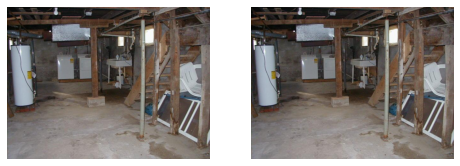

In [10]:
plot_ade_row(this_dial, 71)

In [7]:
reformat_dial_pp(dial[0])

p/playroom


,time,A-private,public,B-private,user,receiver
10,0 days 00:00:03,GM: url: / a/ art_studio/ ADE_train_00001745.jpg,,,GM,A
12,0 days 00:00:03,GM: You can go: [/ n]orth [/ e]ast,,,GM,A
13,0 days 00:00:03,"GM: Welcome to the game, deep_scissors! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",,,GM,A
14,0 days 00:00:03,GM: You have to meet in the room of type: p/ playroom,,,GM,A
15,0 days 00:00:03,,,GM: url: / g/ garage/ outdoor/ ADE_train_00008504.jpg,GM,B
17,0 days 00:00:04,,,GM: You can go: [/ w]est,GM,B
18,0 days 00:00:04,,,"GM: Welcome to the game, sticky_eraser! You can always type the command/ look to see viable directions you can walk to. Type / doneif you think both of you are in the same room.",GM,B
19,0 days 00:00:04,,,GM: You have to meet in the room of type: p/ playroom,GM,B
20,0 days 00:00:08,,,B: cmd: n,B,All
21,0 days 00:00:09,,,GM: Nothing happened.You can go: [/ w]est,GM,B


None

,time,public,user,receiver
0,0 days 00:00:00,A:,A,All
1,0 days 00:00:01,B:,B,All
2,0 days 00:00:01,GM:,GM,All
3,0 days 00:00:01,,GM,All
4,0 days 00:00:02,,GM,All
...,...,...,...,...
96,0 days 00:03:52,B:,B,All
97,0 days 00:03:53,,GM,A
98,0 days 00:03:56,A:,A,All
99,0 days 00:03:56,,GM,B


In [12]:
final_df = df.loc[df['public'] != ""]

In [13]:
final_df

,time,public,user,receiver
0,0 days 00:00:00,A:,A,All
1,0 days 00:00:01,B:,B,All
2,0 days 00:00:01,GM:,GM,All
47,0 days 00:01:13,"GM: The '/done' command has been issued by you or your partner. To finish the game, both players need to enter '/done'",GM,All
53,0 days 00:01:47,"GM: The '/done' command has been issued by you or your partner. To finish the game, both players need to enter '/done'",GM,All
54,0 days 00:02:19,A: I am in the basement are u?,A,All
55,0 days 00:02:34,A: I see a water heater and stairs and a sin,A,All
56,0 days 00:03:01,GM: Attention: you are in the game for 3 minutes!,GM,All
58,0 days 00:03:06,"GM: The '/done' command has been issued by you or your partner. To finish the game, both players need to enter '/done'",GM,All
59,0 days 00:03:09,B: i will find i,B,All
